# Compile and Clean Training Datasets

This notebook compiles training datasets of images of faces with and without masks annotated with the location of the face in the image and labelled indicating whether the face is wearing a mask or not. There are additional labels to indicate if the mask is worn improperly as well as for other types of masks (face shields, neck gaitors, winter scarfs, etc.).

This script compiles all of the image file names and labels (including the labels and locations of faces) into a single spreadsheet.

# NOTE: cleaned dataset to remove duplicate annotations (where the face is annotated twice in an image) -- see Dataset 2


* [Dataset 1](#ds1)
* [Dataset 2](#ds2)
* [Dataset 3](#ds3)
* [Dataset 4](#ds4)
* [Dataset 5 (not using!)](#ds5)

* [Compiled Dataset](#comp)



In [2]:
import numpy as np 
import pandas as pd 
import os
import matplotlib.pyplot as plt
import cv2
import matplotlib.patches as patches
import tensorflow as tf
from keras.layers import Flatten, Dense, Conv2D, MaxPooling2D, Dropout
from keras.models import Sequential

from mtcnn.mtcnn import MTCNN # TODO: what is this?

# Load in Image Data and Labels



<a id='ds1'></a>
## Dataset 1
#### Data obtained from:
https://www.kaggle.com/alexandralorenzo/yolov3-startkit/data


More info: https://medium.com/face-mask-detector-using-deep-learning-yolov3/face-mask-detector-using-deep-learning-yolov3-209b57f77e92


In [3]:
# for reading data from:
#      https://www.kaggle.com/alexandralorenzo/yolov3-startkit/data
# 1 indicates no mask
# 0 indicates mask
import glob
image_file_dir="../Dataset/yolo/images/"
annotation_file_dir="../Dataset/yolo/labels/"


# NOTE: this dataset comes with a training and validation set, since both are labelled I will combine them here
# image files
img_file_names=['train/'+x for x in os.listdir("../Dataset/yolo/images/train")]+['valid/'+x for x in os.listdir("../Dataset/yolo/images/valid")]
img_file_names = [x for x in img_file_names if x!= '.DS_Store']
img_file_names.sort()
# annotation files
annotation_file_names=['train/'+x for x in os.listdir("../Dataset/yolo/labels/train")]+['valid/'+x for x in os.listdir("../Dataset/yolo/labels/valid")]
annotation_file_names = [x for x in annotation_file_names if x!= '.DS_Store']
annotation_file_names.sort()

# Only keep images/annotations if they have a corresponding annotation/image
img_file_names = [y for y in img_file_names if y.split('.')[0] in [x.split('.')[0] for x in annotation_file_names]]
annotation_file_names = [y for y in annotation_file_names if y.split('.')[0] in [x.split('.')[0] for x in img_file_names]]

print(len(img_file_names),"Image files")
print(len(annotation_file_names),"Annotation files")

print(img_file_names[0:10])
print(annotation_file_names[0:10])


1026 Image files
1026 Annotation files
['train/10.jpg', 'train/100.jpg', 'train/101.jpg', 'train/102.jpg', 'train/104.jpg', 'train/105.jpg', 'train/106.jpg', 'train/107.jpg', 'train/108.jpg', 'train/109.jpg']
['train/10.txt', 'train/100.txt', 'train/101.txt', 'train/102.txt', 'train/104.txt', 'train/105.txt', 'train/106.txt', 'train/107.txt', 'train/108.txt', 'train/109.txt']


Example Training Image


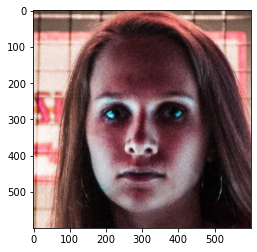

In [4]:
print("Example Training Image")
img=plt.imread(image_file_dir+img_file_names[0])
plt.imshow(img)
plt.show()



# Read in Image Annotations and put into a dataframe



In [5]:
data_ls = []
for fl in annotation_file_names:
    with open(annotation_file_dir+fl,"r+") as f:
        data_ls.append([[fl.split(".")[0]+".jpg"] + x.replace("\n","").split(' ') for x in f.readlines()])

print("Loaded in",len(data_ls),"annotations from",len(annotation_file_names),"annotation files")

# Flatten list and convert to a dataframe
import functools
import operator
data_ls = functools.reduce(operator.iconcat, data_ls, [])
train = pd.DataFrame(data_ls)
train.columns = ['name','classname','x_center','y_center','width','height',]
train.classname = train.classname.astype(int)
train.x_center = train['x_center'].astype(float)
train.y_center = train['y_center'].astype(float)
train.width = train['width'].astype(float)
train.height = train['height'].astype(float)
def convert_class_name(x):
    # 1 indicates no mask
    # 0 indicates mask
    if x == 1:
        return 'face_no_mask'
    if x == 0:
        return 'face_with_mask'
train.classname = train.classname.apply(lambda x: convert_class_name(x))
train = train[['name','x_center','y_center','width','height','classname']] # reorder columns

# Add column indicating the location of the image file
train['image_file_dir'] = len(train)*[image_file_dir]

display(train)



Loaded in 1026 annotations from 1026 annotation files


,name,x_center,y_center,width,height,classname,image_file_dir
0,train/10.jpg,0.523976,0.620614,0.561404,0.574561,face_no_mask,../Dataset/yolo/images/
1,train/100.jpg,0.496930,0.628655,0.615497,0.616959,face_no_mask,../Dataset/yolo/images/
2,train/101.jpg,0.511550,0.664473,0.507310,0.574561,face_no_mask,../Dataset/yolo/images/
3,train/102.jpg,0.561989,0.687135,0.652047,0.578947,face_no_mask,../Dataset/yolo/images/
4,train/104.jpg,0.482310,0.626462,0.671053,0.656433,face_no_mask,../Dataset/yolo/images/
...,...,...,...,...,...,...,...
1562,valid/new_76.jpg,0.554679,0.631580,0.470760,0.637427,face_no_mask,../Dataset/yolo/images/
1563,valid/new_78.jpg,0.490351,0.643274,0.558480,0.616959,face_no_mask,../Dataset/yolo/images/
1564,valid/new_79.jpg,0.485965,0.630847,0.508772,0.554094,face_no_mask,../Dataset/yolo/images/
1565,valid/new_90.jpg,0.511550,0.702486,0.577485,0.527778,face_no_mask,../Dataset/yolo/images/


## Add bounding box to training set data


In [6]:
bbox=[]
for i in range(len(train)):
    arr=[]
    for j in train.iloc[i][['x_center','y_center','width','height']]:
        arr.append(j)
    bbox.append(arr)
train["bbox"]=bbox  

def get_boxes(id):
    boxes=[]
    for i in train[train["name"]==str(id)]["bbox"]:
        boxes.append(i)
    return boxes

display(train)

,name,x_center,y_center,width,height,classname,image_file_dir,bbox
0,train/10.jpg,0.523976,0.620614,0.561404,0.574561,face_no_mask,../Dataset/yolo/images/,"[0.523976, 0.620614, 0.561404, 0.574561]"
1,train/100.jpg,0.496930,0.628655,0.615497,0.616959,face_no_mask,../Dataset/yolo/images/,"[0.49693, 0.628655, 0.615497, 0.616959]"
2,train/101.jpg,0.511550,0.664473,0.507310,0.574561,face_no_mask,../Dataset/yolo/images/,"[0.51155, 0.664473, 0.50731, 0.574561]"
3,train/102.jpg,0.561989,0.687135,0.652047,0.578947,face_no_mask,../Dataset/yolo/images/,"[0.561989, 0.687135, 0.652047, 0.578947]"
4,train/104.jpg,0.482310,0.626462,0.671053,0.656433,face_no_mask,../Dataset/yolo/images/,"[0.48231, 0.626462, 0.671053, 0.656433]"
...,...,...,...,...,...,...,...,...
1562,valid/new_76.jpg,0.554679,0.631580,0.470760,0.637427,face_no_mask,../Dataset/yolo/images/,"[0.554679, 0.63158, 0.47076, 0.637427]"
1563,valid/new_78.jpg,0.490351,0.643274,0.558480,0.616959,face_no_mask,../Dataset/yolo/images/,"[0.490351, 0.643274, 0.55848, 0.616959]"
1564,valid/new_79.jpg,0.485965,0.630847,0.508772,0.554094,face_no_mask,../Dataset/yolo/images/,"[0.485965, 0.630847, 0.508772, 0.554094]"
1565,valid/new_90.jpg,0.511550,0.702486,0.577485,0.527778,face_no_mask,../Dataset/yolo/images/,"[0.51155, 0.702486, 0.577485, 0.527778]"


# Plot some of the annotated data

name                                        train/150.jpg
x_center                                         0.484503
y_center                                         0.625731
width                                             0.55848
height                                           0.622807
classname                                    face_no_mask
image_file_dir                    ../Dataset/yolo/images/
bbox              [0.484503, 0.625731, 0.55848, 0.622807]
Name: 50, dtype: object
Rectangle(xy=(123, 188), width=335, height=373, angle=0)
name                                    train/151.jpg
x_center                                     0.475731
y_center                                     0.667397
width                                             0.5
height                                       0.571637
classname                                face_no_mask
image_file_dir                ../Dataset/yolo/images/
bbox              [0.475731, 0.667397, 0.5, 0.571637]
Name: 51, dtype: object

name                                         train/165.jpg
x_center                                          0.495468
y_center                                          0.677631
width                                             0.545322
height                                            0.565789
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.495468, 0.677631, 0.545322, 0.565789]
Name: 65, dtype: object
Rectangle(xy=(133, 236), width=327, height=339, angle=0)
name                                         train/166.jpg
x_center                                          0.534211
y_center                                          0.703948
width                                             0.546784
height                                            0.519006
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.534211, 0.703

<ipython-input-12-993b8b0a35ec>:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1)


name                                         train/171.jpg
x_center                                          0.472808
y_center                                          0.627193
width                                             0.596491
height                                            0.608187
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.472808, 0.627193, 0.596491, 0.608187]
Name: 71, dtype: object
Rectangle(xy=(104, 193), width=357, height=364, angle=0)
name                                      train/172.jpg
x_center                                       0.514659
y_center                                       0.722828
width                                          0.618947
height                                            0.528
classname                                  face_no_mask
image_file_dir                  ../Dataset/yolo/images/
bbox              [0.514659, 0.722828, 0.618947, 0.528]

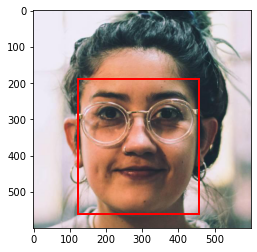

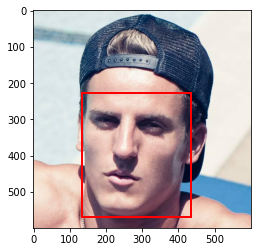

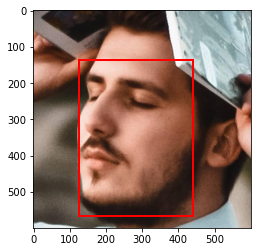

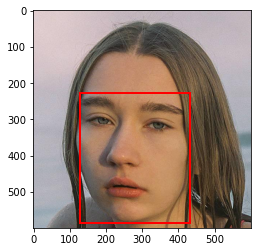

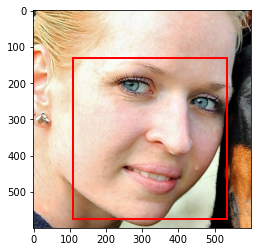

...

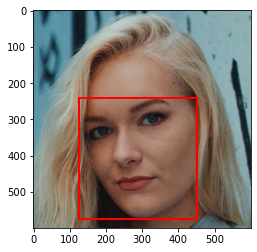

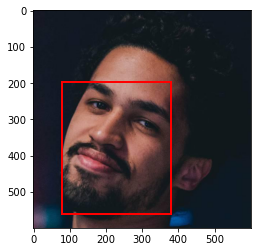

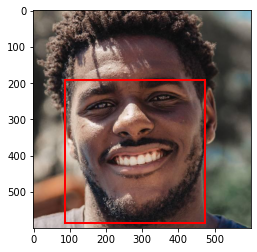

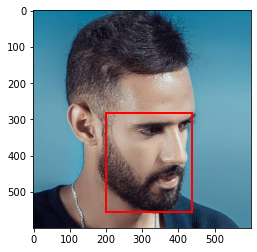

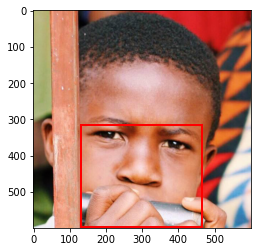

In [12]:
for i in range(50,80):#-1,-2,-3,1,2,3]:# check negative indicies to ensure both train and valid image files can be read in
    dat = train.iloc[i]
    print(dat)
    img=plt.imread(image_file_dir+dat['name'])

    fig,ax = plt.subplots(1)
    ax.imshow(img)
    box=dat.bbox
    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size
    rect = patches.Rectangle(
        (int((box[0]*img_width)-((box[2]/2)*img_width)),
        int((box[1]*img_height)-((box[3]/2)*img_height))),
        int((box[2])*img_width),
        int((box[3])*img_height),
        linewidth=2,edgecolor='r',facecolor='none'
    )
    print(rect)
    ax.add_patch(rect)
#     plt.savefig("plots/"+str(i)+"_temp.png",dpi=300)


    plt.show()
    

### Convert bounding box coordinates to be consistent with other datasets

In [19]:
new_bbox = []

for index,row in train.iterrows():
    img=plt.imread(image_file_dir+row['name'])
    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size
    box=row.bbox
    new_box = [
    int((box[0]*img_width)-((box[2]/2)*img_width)),
    int((box[1]*img_height)-((box[3]/2)*img_height)),
    int((box[2])*img_width),
    int((box[3])*img_height)]
#     row.bbox = new_box
    new_bbox.append(new_box)
    
train.bbox=new_bbox    
display(train)    


,name,x_center,y_center,width,height,classname,image_file_dir,bbox
0,train/10.jpg,0.523976,0.620614,0.561404,0.574561,face_no_mask,../Dataset/yolo/images/,"[145, 200, 336, 344]"
1,train/100.jpg,0.496930,0.628655,0.615497,0.616959,face_no_mask,../Dataset/yolo/images/,"[113, 192, 369, 370]"
2,train/101.jpg,0.511550,0.664473,0.507310,0.574561,face_no_mask,../Dataset/yolo/images/,"[154, 226, 304, 344]"
3,train/102.jpg,0.561989,0.687135,0.652047,0.578947,face_no_mask,../Dataset/yolo/images/,"[141, 238, 391, 347]"
4,train/104.jpg,0.482310,0.626462,0.671053,0.656433,face_no_mask,../Dataset/yolo/images/,"[88, 178, 402, 393]"
...,...,...,...,...,...,...,...,...
1562,valid/new_76.jpg,0.554679,0.631580,0.470760,0.637427,face_no_mask,../Dataset/yolo/images/,"[191, 187, 282, 382]"
1563,valid/new_78.jpg,0.490351,0.643274,0.558480,0.616959,face_no_mask,../Dataset/yolo/images/,"[126, 200, 335, 370]"
1564,valid/new_79.jpg,0.485965,0.630847,0.508772,0.554094,face_no_mask,../Dataset/yolo/images/,"[138, 212, 305, 332]"
1565,valid/new_90.jpg,0.511550,0.702486,0.577485,0.527778,face_no_mask,../Dataset/yolo/images/,"[133, 263, 346, 316]"


## Plot some of the data using the updated bbox values


name                                      valid/new_94.jpg
x_center                                          0.486696
y_center                                          0.696637
width                                             0.557018
height                                            0.495614
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.486696, 0.696637, 0.557018, 0.495614]
Name: 1566, dtype: object
bbox: [0.486696, 0.696637, 0.557018, 0.495614]
Rectangle: Rectangle(xy=(0.486696, 0.696637), width=0.557018, height=0.495614, angle=0)


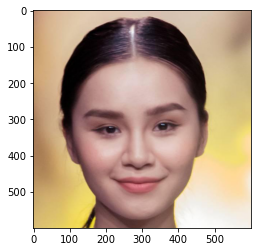

name                                     valid/new_90.jpg
x_center                                          0.51155
y_center                                         0.702486
width                                            0.577485
height                                           0.527778
classname                                    face_no_mask
image_file_dir                    ../Dataset/yolo/images/
bbox              [0.51155, 0.702486, 0.577485, 0.527778]
Name: 1565, dtype: object
bbox: [0.51155, 0.702486, 0.577485, 0.527778]
Rectangle: Rectangle(xy=(0.51155, 0.702486), width=0.577485, height=0.527778, angle=0)


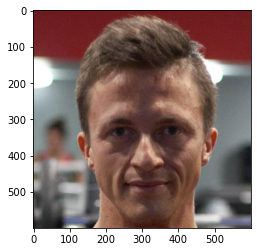

name                                      valid/new_79.jpg
x_center                                          0.485965
y_center                                          0.630847
width                                             0.508772
height                                            0.554094
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.485965, 0.630847, 0.508772, 0.554094]
Name: 1564, dtype: object
bbox: [0.485965, 0.630847, 0.508772, 0.554094]
Rectangle: Rectangle(xy=(0.485965, 0.630847), width=0.508772, height=0.554094, angle=0)


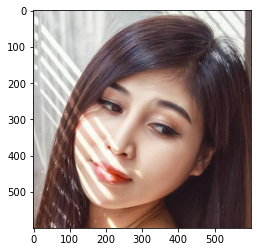

name                                        train/100.jpg
x_center                                          0.49693
y_center                                         0.628655
width                                            0.615497
height                                           0.616959
classname                                    face_no_mask
image_file_dir                    ../Dataset/yolo/images/
bbox              [0.49693, 0.628655, 0.615497, 0.616959]
Name: 1, dtype: object
bbox: [0.49693, 0.628655, 0.615497, 0.616959]
Rectangle: Rectangle(xy=(0.49693, 0.628655), width=0.615497, height=0.616959, angle=0)


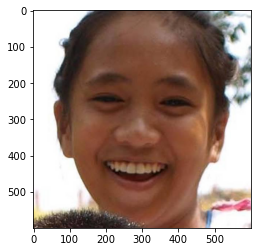

name                                       train/101.jpg
x_center                                         0.51155
y_center                                        0.664473
width                                            0.50731
height                                          0.574561
classname                                   face_no_mask
image_file_dir                   ../Dataset/yolo/images/
bbox              [0.51155, 0.664473, 0.50731, 0.574561]
Name: 2, dtype: object
bbox: [0.51155, 0.664473, 0.50731, 0.574561]
Rectangle: Rectangle(xy=(0.51155, 0.664473), width=0.50731, height=0.574561, angle=0)


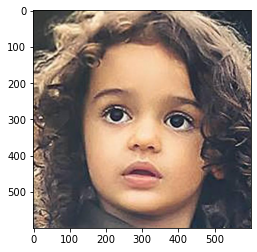

name                                         train/102.jpg
x_center                                          0.561989
y_center                                          0.687135
width                                             0.652047
height                                            0.578947
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.561989, 0.687135, 0.652047, 0.578947]
Name: 3, dtype: object
bbox: [0.561989, 0.687135, 0.652047, 0.578947]
Rectangle: Rectangle(xy=(0.561989, 0.687135), width=0.652047, height=0.578947, angle=0)


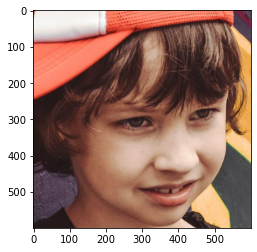

In [14]:
for index in [-1,-2,-3,1,2,3]:# check negative indicies to ensure both train and valid image files can be read in
    # Show example training image with bounding box after updating bbox in dataframe
    dat = train.iloc[index]
    print(dat)
    img=plt.imread(image_file_dir+dat['name'])
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    box=dat.bbox
    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size
    print("bbox:",box)
    rect = patches.Rectangle(
        (box[0],box[1]),box[2],box[3],
        linewidth=2,edgecolor='r',facecolor='none'
    )
    print("Rectangle:",rect)
    ax.add_patch(rect)
#     plt.save_fig("plots/"+str(i)+"_temp.png",dpi=300)
    plt.show()





## Relabel Classifiers
For this dataset there are only 2 classifiers and they are labelled correctly so we don't have to do anything here

In [15]:
set(train.classname)


{'face_no_mask', 'face_with_mask'}

## Plot some of the data to be sure classifiers make sense
Plot some with masks and some without

name                                      valid/new_63.jpg
x_center                                          0.622588
y_center                                          0.248538
width                                             0.208333
height                                            0.131579
classname                                   face_with_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.622588, 0.248538, 0.208333, 0.131579]
Name: 1555, dtype: object
bbox: [0.622588, 0.248538, 0.208333, 0.131579]
Rectangle: Rectangle(xy=(0.622588, 0.248538), width=0.208333, height=0.131579, angle=0)


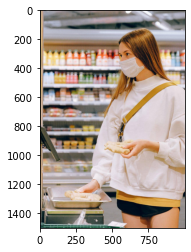

name                                      valid/new_62.jpg
x_center                                          0.549619
y_center                                          0.219338
width                                             0.084838
height                                            0.146199
classname                                   face_with_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.549619, 0.219338, 0.084838, 0.146199]
Name: 1554, dtype: object
bbox: [0.549619, 0.219338, 0.084838, 0.146199]
Rectangle: Rectangle(xy=(0.549619, 0.219338), width=0.084838, height=0.146199, angle=0)


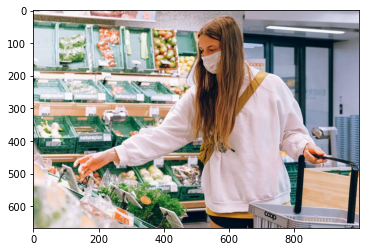

name                                   valid/new_59.jpg
x_center                                          0.672
y_center                                       0.325332
width                                          0.179427
height                                         0.255848
classname                                face_with_mask
image_file_dir                  ../Dataset/yolo/images/
bbox              [0.672, 0.325332, 0.179427, 0.255848]
Name: 1553, dtype: object
bbox: [0.672, 0.325332, 0.179427, 0.255848]
Rectangle: Rectangle(xy=(0.672, 0.325332), width=0.179427, height=0.255848, angle=0)


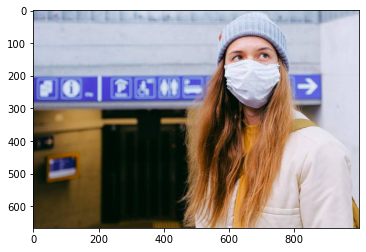

name                                     valid/new_90.jpg
x_center                                          0.51155
y_center                                         0.702486
width                                            0.577485
height                                           0.527778
classname                                    face_no_mask
image_file_dir                    ../Dataset/yolo/images/
bbox              [0.51155, 0.702486, 0.577485, 0.527778]
Name: 1565, dtype: object
bbox: [0.51155, 0.702486, 0.577485, 0.527778]
Rectangle: Rectangle(xy=(0.51155, 0.702486), width=0.577485, height=0.527778, angle=0)


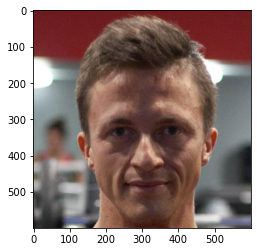

name                                      valid/new_79.jpg
x_center                                          0.485965
y_center                                          0.630847
width                                             0.508772
height                                            0.554094
classname                                     face_no_mask
image_file_dir                     ../Dataset/yolo/images/
bbox              [0.485965, 0.630847, 0.508772, 0.554094]
Name: 1564, dtype: object
bbox: [0.485965, 0.630847, 0.508772, 0.554094]
Rectangle: Rectangle(xy=(0.485965, 0.630847), width=0.508772, height=0.554094, angle=0)


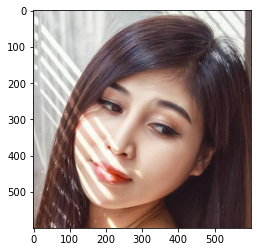

name                                     valid/new_78.jpg
x_center                                         0.490351
y_center                                         0.643274
width                                             0.55848
height                                           0.616959
classname                                    face_no_mask
image_file_dir                    ../Dataset/yolo/images/
bbox              [0.490351, 0.643274, 0.55848, 0.616959]
Name: 1563, dtype: object
bbox: [0.490351, 0.643274, 0.55848, 0.616959]
Rectangle: Rectangle(xy=(0.490351, 0.643274), width=0.55848, height=0.616959, angle=0)


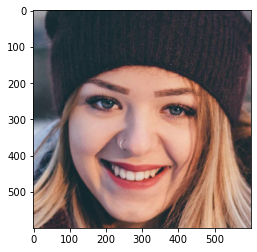

In [16]:
for index in (
    list(train[train['classname'] == 'face_with_mask'].index)[::-1][1:4]+ # 4 with masks
    list(train[train['classname'] == 'face_no_mask'].index)[::-1][1:4]): # 4 without masks
    # Show example training image with bounding box after updating bbox in dataframe
    dat = train.iloc[index]
    print(dat)
    img=plt.imread(image_file_dir+dat['name'])
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    box=dat.bbox
    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size
    print("bbox:",box)
    rect = patches.Rectangle(
        (box[0],box[1]),box[2],box[3],
        linewidth=2,edgecolor='r',facecolor='none'
    )
    print("Rectangle:",rect)
    ax.add_patch(rect)
    plt.show()





## Reformat annotation file so it will match other datasets before saving

In [18]:
# create columns for box annotations
def get_x1(x):
    return x[0]

def get_x2(x):
    return x[1]

def get_y1(x):
    return x[2]

def get_y2(x):
    return x[3]

# convert bounding box to columns
train['x1']=train['bbox'].apply(lambda x: get_x1(x))
train['x2']=train['bbox'].apply(lambda x: get_x2(x))
train['y1']=train['bbox'].apply(lambda x: get_y1(x))
train['y2']=train['bbox'].apply(lambda x: get_y2(x))


# drop unnecessary columns
train = train[['name', 'x1', 'x2', 'y1', 'y2', 'classname','image_file_dir']]


display(train)


,name,x1,x2,y1,y2,classname,image_file_dir
0,train/10.jpg,0.523976,0.620614,0.561404,0.574561,face_no_mask,../Dataset/yolo/images/
1,train/100.jpg,0.496930,0.628655,0.615497,0.616959,face_no_mask,../Dataset/yolo/images/
2,train/101.jpg,0.511550,0.664473,0.507310,0.574561,face_no_mask,../Dataset/yolo/images/
3,train/102.jpg,0.561989,0.687135,0.652047,0.578947,face_no_mask,../Dataset/yolo/images/
4,train/104.jpg,0.482310,0.626462,0.671053,0.656433,face_no_mask,../Dataset/yolo/images/
...,...,...,...,...,...,...,...
1562,valid/new_76.jpg,0.554679,0.631580,0.470760,0.637427,face_no_mask,../Dataset/yolo/images/
1563,valid/new_78.jpg,0.490351,0.643274,0.558480,0.616959,face_no_mask,../Dataset/yolo/images/
1564,valid/new_79.jpg,0.485965,0.630847,0.508772,0.554094,face_no_mask,../Dataset/yolo/images/
1565,valid/new_90.jpg,0.511550,0.702486,0.577485,0.527778,face_no_mask,../Dataset/yolo/images/


In [19]:
# update name and image_file_dir
image_file_dir_ls = []
name_ls = []
for index,row in train.iterrows():
    image_file_dir_ls.append(row['image_file_dir']+row['name'].split('/')[0]+"/")
    name_ls.append(row['name'].split('/')[1])
    
    
train['name'] = name_ls
train['image_file_dir'] = image_file_dir_ls
display(train)


,name,x1,x2,y1,y2,classname,image_file_dir
0,10.jpg,0.523976,0.620614,0.561404,0.574561,face_no_mask,../Dataset/yolo/images/train/
1,100.jpg,0.496930,0.628655,0.615497,0.616959,face_no_mask,../Dataset/yolo/images/train/
2,101.jpg,0.511550,0.664473,0.507310,0.574561,face_no_mask,../Dataset/yolo/images/train/
3,102.jpg,0.561989,0.687135,0.652047,0.578947,face_no_mask,../Dataset/yolo/images/train/
4,104.jpg,0.482310,0.626462,0.671053,0.656433,face_no_mask,../Dataset/yolo/images/train/
...,...,...,...,...,...,...,...
1562,new_76.jpg,0.554679,0.631580,0.470760,0.637427,face_no_mask,../Dataset/yolo/images/valid/
1563,new_78.jpg,0.490351,0.643274,0.558480,0.616959,face_no_mask,../Dataset/yolo/images/valid/
1564,new_79.jpg,0.485965,0.630847,0.508772,0.554094,face_no_mask,../Dataset/yolo/images/valid/
1565,new_90.jpg,0.511550,0.702486,0.577485,0.527778,face_no_mask,../Dataset/yolo/images/valid/


## Test reading in some data and plotting Boxes

name                                 new_17.jpg
x1                                     0.731367
x2                                     0.336264
y1                                      0.15229
y2                                     0.160819
classname                        face_with_mask
image_file_dir    ../Dataset/yolo/images/valid/
Name: 1505, dtype: object
Rectangle: Rectangle(xy=(0.731367, 0.336264), width=0.15229, height=0.160819, angle=0)
name                                 new_15.jpg
x1                                     0.272716
x2                                     0.247657
y1                                     0.142193
y2                                     0.244331
classname                        face_with_mask
image_file_dir    ../Dataset/yolo/images/valid/
Name: 1493, dtype: object
Rectangle: Rectangle(xy=(0.272716, 0.247657), width=0.142193, height=0.244331, angle=0)
name                                 new_13.jpg
x1                                     0.580826
x2   

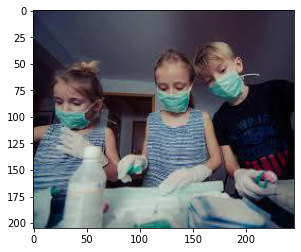

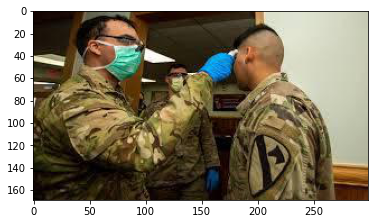

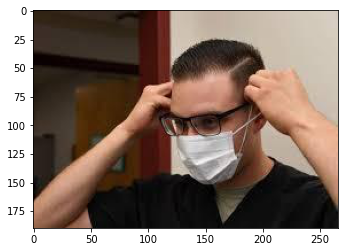

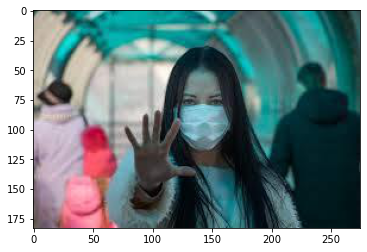

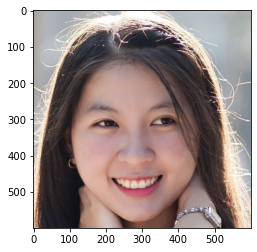

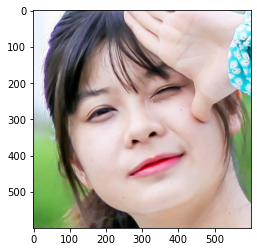

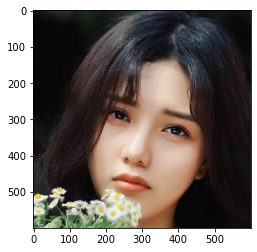

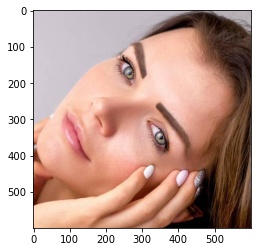

In [20]:
for index in (
    list(train[train['classname'] == 'face_with_mask'].index)[::-1][26:30]+ # 4 with masks
    list(train[train['classname'] == 'face_no_mask'].index)[::-1][26:30]): # 4 without masks
    # Show example training image with bounding box after updating bbox in dataframe
    dat = train.iloc[index]
    print(dat)
    img=plt.imread(dat['image_file_dir']+dat['name'])
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    rect = patches.Rectangle((dat['x1'],dat['x2']),
                             dat['y1'],
                             dat['y2'],linewidth=2,edgecolor='r',facecolor='none')
    print("Rectangle:",rect)
    ax.add_patch(rect)
    plt.savefig("plots/"+str(index)+"_temp.png",dpi=300)


#     plt.show()






## Finalized Dataframe for this dataset

In [26]:
display(train)


,name,x1,x2,y1,y2,classname,image_file_dir
0,10.jpg,145,200,336,344,face_no_mask,../Dataset/yolo/images/train/
1,100.jpg,113,192,369,370,face_no_mask,../Dataset/yolo/images/train/
2,101.jpg,154,226,304,344,face_no_mask,../Dataset/yolo/images/train/
3,102.jpg,141,238,391,347,face_no_mask,../Dataset/yolo/images/train/
4,104.jpg,88,178,402,393,face_no_mask,../Dataset/yolo/images/train/
...,...,...,...,...,...,...,...
1562,new_76.jpg,191,187,282,382,face_no_mask,../Dataset/yolo/images/valid/
1563,new_78.jpg,126,200,335,370,face_no_mask,../Dataset/yolo/images/valid/
1564,new_79.jpg,138,212,305,332,face_no_mask,../Dataset/yolo/images/valid/
1565,new_90.jpg,133,263,346,316,face_no_mask,../Dataset/yolo/images/valid/


## Export annotation to a csv file



In [27]:
out_file = 'yolo_labels_km-annotated.csv'
train.to_csv(out_file,index=False)
print("Annotation File saved to:",out_file)



Annotation File saved to: yolo_labels_km-annotated.csv


<a id='ds2'></a>
## Dataset 2
#### Data obtained from:
https://www.kaggle.com/wobotintelligence/face-mask-detection-dataset
    

In [28]:
# Read in file containing annotations of the mask image data (NOTE: the submission.csv file correlates to unlabelled images and therefore will not be included here)
# TODO: make sure the compiled training image dataset ONLY contains the LABELLED images 
train=pd.read_csv("../Dataset/mask_image_data/train.csv")
display(train)
image_file_dir = "../Dataset/mask_image_data/images/"

# sort dataframe by file name and reindex
train.sort_values(by="name",inplace=True)
train.reset_index(inplace = True)

print('Dataset contains',len(list(set(train['name']))),'image files with a total of',len(train),'annotations')




,name,x1,x2,y1,y2,classname
0,2756.png,69,126,294,392,face_with_mask
1,2756.png,505,10,723,283,face_with_mask
2,2756.png,75,252,264,390,mask_colorful
3,2756.png,521,136,711,277,mask_colorful
4,6098.jpg,360,85,728,653,face_no_mask
...,...,...,...,...,...,...
15407,1894.jpg,437,121,907,644,face_with_mask
15408,1894.jpg,557,363,876,636,mask_surgical
15409,1894.jpg,411,3,940,325,hat
15410,3216.png,126,69,409,463,face_with_mask


Dataset contains 4326 image files with a total of 15412 annotations


## Add column to dataframe for image file location

In [29]:
train['image_file_dir'] = len(train)*[image_file_dir]
train


,index,name,x1,x2,y1,y2,classname,image_file_dir
0,13381,1801.jpg,451,186,895,697,face_no_mask,../Dataset/mask_image_data/images/
1,3464,1802.jpg,160,151,268,265,mask_surgical,../Dataset/mask_image_data/images/
2,3463,1802.jpg,110,71,273,272,face_with_mask,../Dataset/mask_image_data/images/
3,14836,1803.jpg,147,200,288,320,mask_surgical,../Dataset/mask_image_data/images/
4,14835,1803.jpg,126,75,303,333,face_with_mask,../Dataset/mask_image_data/images/
...,...,...,...,...,...,...,...,...
15407,13555,6433.png,669,205,774,282,mask_surgical,../Dataset/mask_image_data/images/
15408,9508,6434.jpg,315,82,775,783,face_with_mask,../Dataset/mask_image_data/images/
15409,9507,6434.jpg,343,448,756,774,mask_colorful,../Dataset/mask_image_data/images/
15410,9434,6435.jpg,198,86,292,149,mask_surgical,../Dataset/mask_image_data/images/


Example Training Image
name                         6435.jpg
classname    face_with_mask_incorrect
index                            9433
Name: 15411, dtype: object


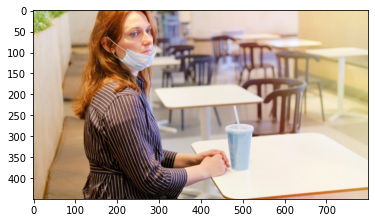

In [30]:
print("Example Training Image")
print(train.iloc[-1][['name','classname','index']])
img=plt.imread(image_file_dir+train.iloc[-1]['name'])
plt.imshow(img)
plt.show()

## Renumber bounding boxes to match other datasets 

In [31]:
bbox_ls=[]
x1_ls = []
x2_ls = []
y1_ls = []
y2_ls = []
for i in range(len(train)):
    arr=[]
    for j in train.iloc[i][["x1",'x2','y1','y2']]:
        arr.append(j) 
    bbox_ls.append([arr[0],arr[1],arr[2]-arr[0],arr[3]-arr[1]])# Renumber bounding boxes to match other datasets
    x1_ls.append(arr[0])
    x2_ls.append(arr[1])
    y1_ls.append(arr[2]-arr[0])
    y2_ls.append(arr[3]-arr[1])
train["bbox"]=bbox_ls  
# update x1,x2,y1,y2 (TODO: do this for other compilation notebook too!!)
train["x1"] = x1_ls
train["x2"] = x2_ls
train["y1"] = y1_ls
train["y2"] = y2_ls


display(train)





,index,name,x1,x2,y1,y2,classname,image_file_dir,bbox
0,13381,1801.jpg,451,186,444,511,face_no_mask,../Dataset/mask_image_data/images/,"[451, 186, 444, 511]"
1,3464,1802.jpg,160,151,108,114,mask_surgical,../Dataset/mask_image_data/images/,"[160, 151, 108, 114]"
2,3463,1802.jpg,110,71,163,201,face_with_mask,../Dataset/mask_image_data/images/,"[110, 71, 163, 201]"
3,14836,1803.jpg,147,200,141,120,mask_surgical,../Dataset/mask_image_data/images/,"[147, 200, 141, 120]"
4,14835,1803.jpg,126,75,177,258,face_with_mask,../Dataset/mask_image_data/images/,"[126, 75, 177, 258]"
...,...,...,...,...,...,...,...,...,...
15407,13555,6433.png,669,205,105,77,mask_surgical,../Dataset/mask_image_data/images/,"[669, 205, 105, 77]"
15408,9508,6434.jpg,315,82,460,701,face_with_mask,../Dataset/mask_image_data/images/,"[315, 82, 460, 701]"
15409,9507,6434.jpg,343,448,413,326,mask_colorful,../Dataset/mask_image_data/images/,"[343, 448, 413, 326]"
15410,9434,6435.jpg,198,86,94,63,mask_surgical,../Dataset/mask_image_data/images/,"[198, 86, 94, 63]"


## Plot Example Bounding Boxes to be sure renumbering went correctly

2888.png has 2 label(s)
['balaclava_ski_mask', 'face_other_covering']


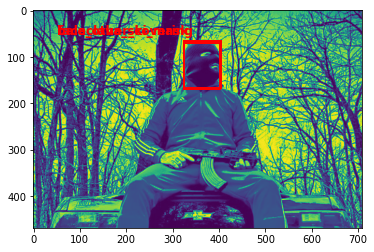

4549.png has 2 label(s)
['face_with_mask', 'mask_colorful']


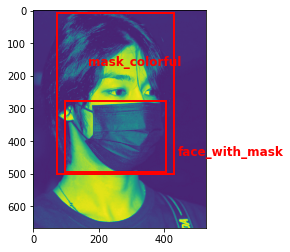

4578.png has 3 label(s)
['face_with_mask', 'mask_colorful', 'hat']


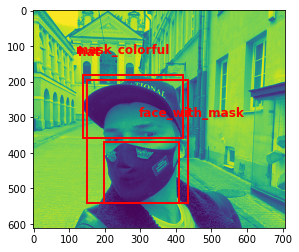

4989.jpg has 3 label(s)
['helmet', 'goggles', 'face_other_covering']


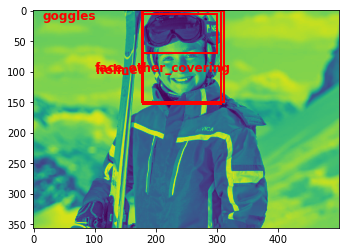

4655.png has 6 label(s)
['face_with_mask', 'mask_surgical', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'eyeglasses']


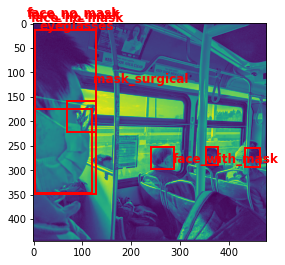

3861.png has 8 label(s)
['hat', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'mask_surgical', 'face_no_mask', 'face_with_mask', 'face_no_mask']


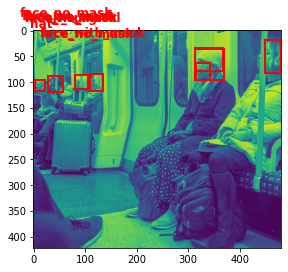

5466.jpg has 1 label(s)
['face_no_mask']


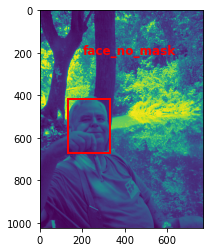

4084.png has 4 label(s)
['face_with_mask', 'mask_colorful', 'mask_colorful', 'face_with_mask']


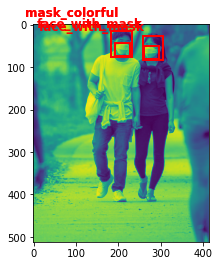

3582.png has 4 label(s)
['face_with_mask', 'face_with_mask', 'mask_colorful', 'mask_colorful']


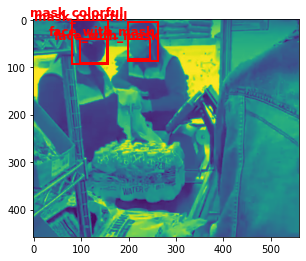

3524.png has 20 label(s)
['hood', 'hood', 'hood', 'hood', 'mask_surgical', 'mask_surgical', 'hood', 'goggles', 'goggles', 'mask_surgical', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'goggles', 'goggles', 'goggles', 'mask_surgical', 'face_with_mask']


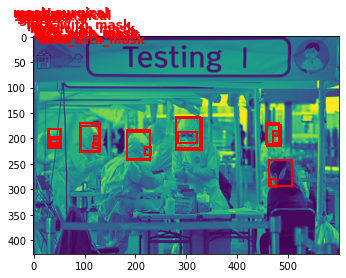

3990.png has 3 label(s)
['sunglasses', 'hijab_niqab', 'face_other_covering']


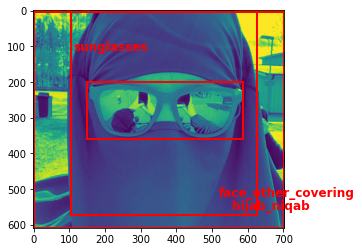

3340.png has 2 label(s)
['mask_colorful', 'face_with_mask']


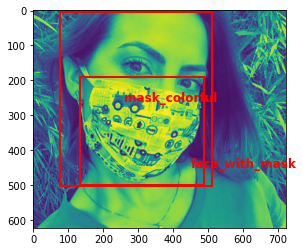

2559.png has 2 label(s)
['mask_colorful', 'face_with_mask']


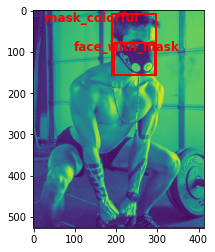

5342.jpg has 3 label(s)
['sunglasses', 'scarf_bandana', 'face_other_covering']


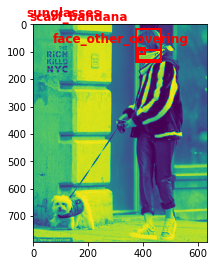

3919.png has 2 label(s)
['face_with_mask', 'mask_colorful']


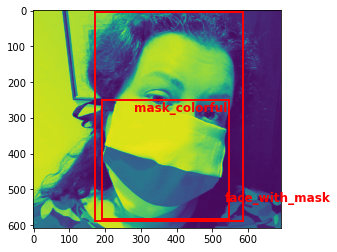

6254.jpg has 1 label(s)
['face_no_mask']


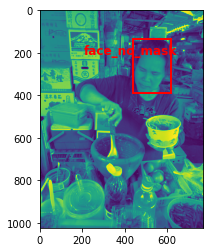

4985.png has 2 label(s)
['face_with_mask', 'mask_surgical']


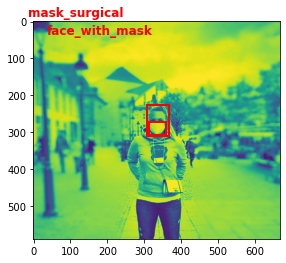

6282.jpg has 7 label(s)
['face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask']


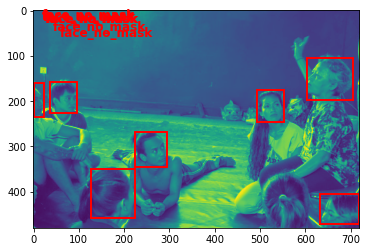

4879.png has 1 label(s)
['face_no_mask']


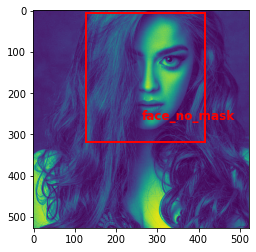

2583.png has 2 label(s)
['face_other_covering', 'sunglasses']


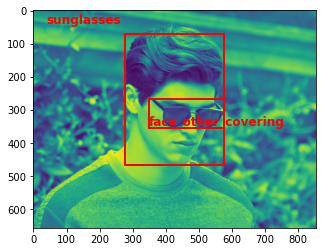

In [32]:
def plot_image_with_all_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
#     img=plt.imread(image_file_dir+img_nm)
    img = cv2.imread(image_file_dir+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for f in list(set(train['name']))[0:20]:
    plot_image_with_all_bboxes(f)





## Classify Data
**Explaination:** This dataset contains a lot of additional information about facial/head coverings that is not relevant to our study. While these would be helpful to include, for simplicity we will exclude these additional annotations. For now we will only include the annotations for masks and rename the classifiers so they are all consistent.
1. Remove rows with irrelevant annotations (ex: 'hat','helmet','sunglasses'
2. Combine and rename relevant annotations (ex: relabel 'mask_colorful' and 'mask_surgical' as 'face_mask' 




In [33]:
# Remove rows in the dataframe that contain information about irrelevant classifiers
irrel_class_ls = ['scarf_bandana', 'gas_mask', 'hood', 'goggles','balaclava_ski_mask','turban',
    'other', 'hair_net', 'hat', 'sunglasses', 'hijab_niqab', 'face_shield', 'helmet', 'eyeglasses']
train = train[~train['classname'].isin(irrel_class_ls)]
def simplify_class_label(x):
    '''Simplifies class lables'''
    # combine mask_colorful and mask_surgical to face_mask
    if x == 'mask_colorful' or x == 'mask_surgical' or x == 'face_mask':
        return 'face_mask'
    elif x == 'face_no_mask':
        return 'face_no_mask'
    elif x == 'face_with_mask':
        return 'face_with_mask'
    elif x == 'face_other_covering': 
        return 'face_other_covering'
    elif x == 'face_with_mask_incorrect': # TODO: we may want to keep this label later
        return 'face_with_mask'
    else:
        print("WARNING:",x,"is not a supported class!")

train['classname'] =train['classname'].apply(lambda x: simplify_class_label(x))
display(train)

print("Classifiers:",set(train['classname']))




<ipython-input-33-1987eabd30ee>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train['classname'] =train['classname'].apply(lambda x: simplify_class_label(x))


,index,name,x1,x2,y1,y2,classname,image_file_dir,bbox
0,13381,1801.jpg,451,186,444,511,face_no_mask,../Dataset/mask_image_data/images/,"[451, 186, 444, 511]"
1,3464,1802.jpg,160,151,108,114,face_mask,../Dataset/mask_image_data/images/,"[160, 151, 108, 114]"
2,3463,1802.jpg,110,71,163,201,face_with_mask,../Dataset/mask_image_data/images/,"[110, 71, 163, 201]"
3,14836,1803.jpg,147,200,141,120,face_mask,../Dataset/mask_image_data/images/,"[147, 200, 141, 120]"
4,14835,1803.jpg,126,75,177,258,face_with_mask,../Dataset/mask_image_data/images/,"[126, 75, 177, 258]"
...,...,...,...,...,...,...,...,...,...
15407,13555,6433.png,669,205,105,77,face_mask,../Dataset/mask_image_data/images/,"[669, 205, 105, 77]"
15408,9508,6434.jpg,315,82,460,701,face_with_mask,../Dataset/mask_image_data/images/,"[315, 82, 460, 701]"
15409,9507,6434.jpg,343,448,413,326,face_mask,../Dataset/mask_image_data/images/,"[343, 448, 413, 326]"
15410,9434,6435.jpg,198,86,94,63,face_mask,../Dataset/mask_image_data/images/,"[198, 86, 94, 63]"


Classifiers: {'face_other_covering', 'face_mask', 'face_with_mask', 'face_no_mask'}


## Show Some "Cleaned-up" Annotations

2888.png has 1 label(s)
['face_other_covering']


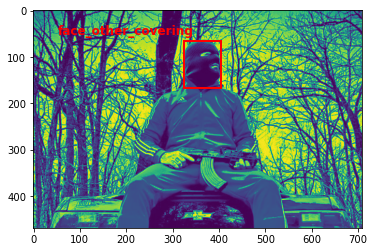

4549.png has 2 label(s)
['face_with_mask', 'face_mask']


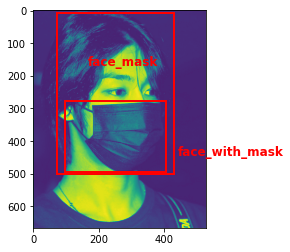

4578.png has 2 label(s)
['face_with_mask', 'face_mask']


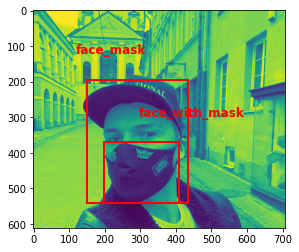

4989.jpg has 1 label(s)
['face_other_covering']


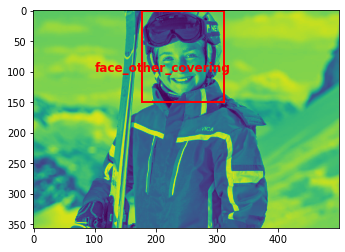

4655.png has 5 label(s)
['face_with_mask', 'face_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask']


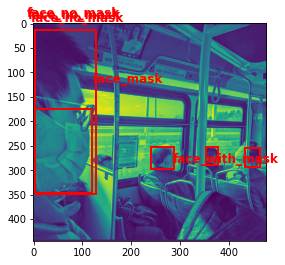

3861.png has 7 label(s)
['face_no_mask', 'face_no_mask', 'face_no_mask', 'face_mask', 'face_no_mask', 'face_with_mask', 'face_no_mask']


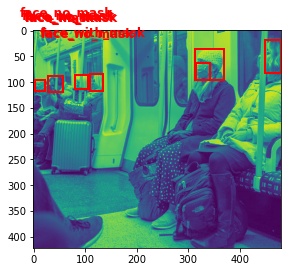

5466.jpg has 1 label(s)
['face_no_mask']


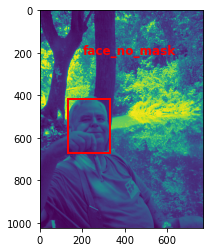

4084.png has 4 label(s)
['face_with_mask', 'face_mask', 'face_mask', 'face_with_mask']


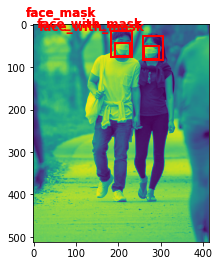

3582.png has 4 label(s)
['face_with_mask', 'face_with_mask', 'face_mask', 'face_mask']


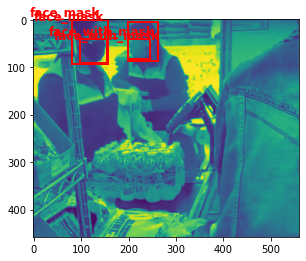

3524.png has 10 label(s)
['face_mask', 'face_mask', 'face_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_mask', 'face_with_mask']


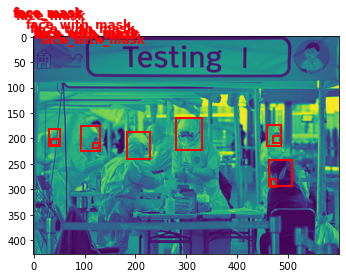

3990.png has 1 label(s)
['face_other_covering']


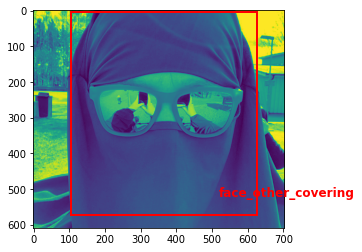

3340.png has 2 label(s)
['face_mask', 'face_with_mask']


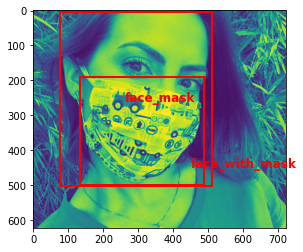

2559.png has 2 label(s)
['face_mask', 'face_with_mask']


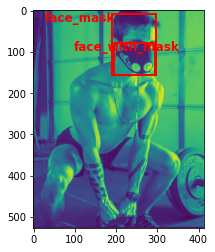

5342.jpg has 1 label(s)
['face_other_covering']


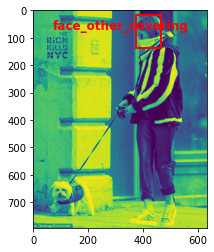

3919.png has 2 label(s)
['face_with_mask', 'face_mask']


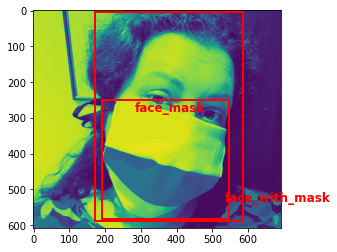

6254.jpg has 1 label(s)
['face_no_mask']


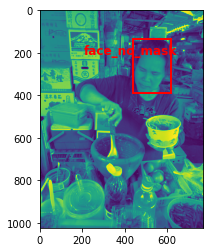

4985.png has 2 label(s)
['face_with_mask', 'face_mask']


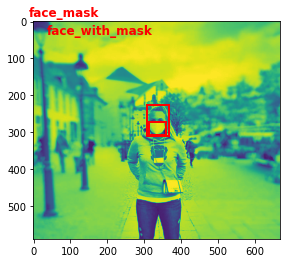

6282.jpg has 7 label(s)
['face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask']


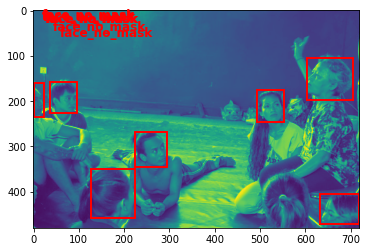

4879.png has 1 label(s)
['face_no_mask']


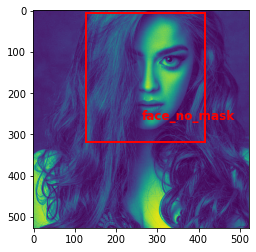

2583.png has 1 label(s)
['face_other_covering']


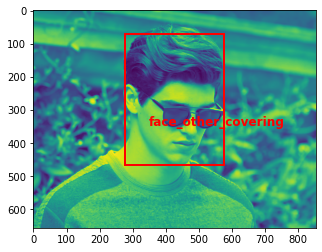

In [38]:
def plot_image_with_all_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
#     img=plt.imread(image_file_dir+img_nm)
    img = cv2.imread(image_file_dir+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for f in list(set(train['name']))[0:20]:
    plot_image_with_all_bboxes(f)





# Show some just mask annotations

2888.png has 1 label(s)
[]


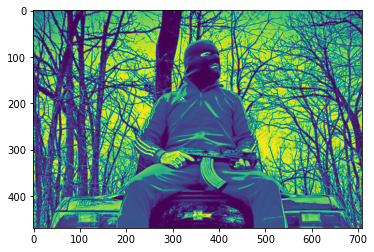

4549.png has 2 label(s)
['face_mask']


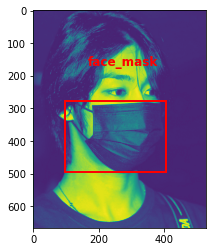

4578.png has 2 label(s)
['face_mask']


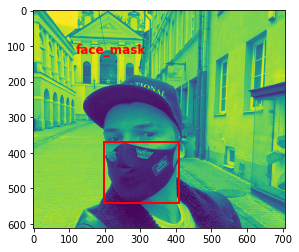

4989.jpg has 1 label(s)
[]


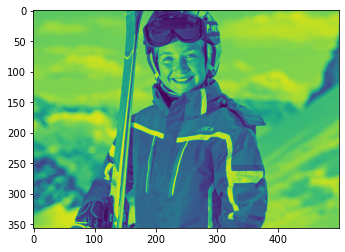

4655.png has 5 label(s)
['face_mask']


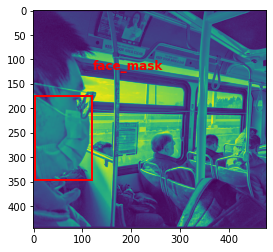

3861.png has 7 label(s)
['face_mask']


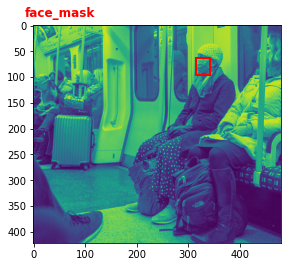

5466.jpg has 1 label(s)
[]


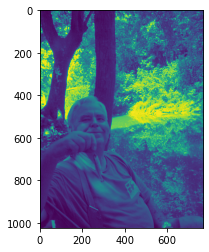

4084.png has 4 label(s)
['face_mask', 'face_mask']


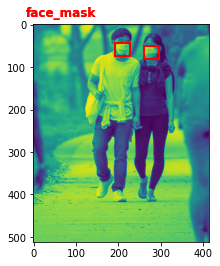

3582.png has 4 label(s)
['face_mask', 'face_mask']


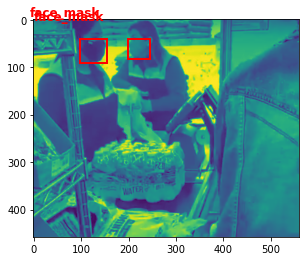

3524.png has 10 label(s)
['face_mask', 'face_mask', 'face_mask', 'face_mask']


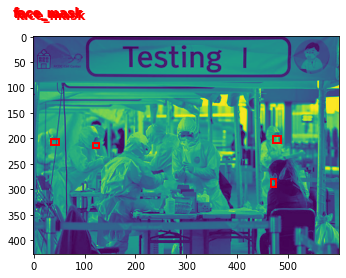

3990.png has 1 label(s)
[]


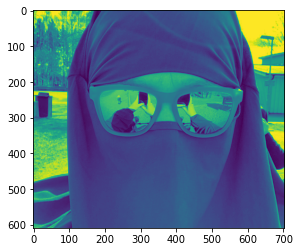

3340.png has 2 label(s)
['face_mask']


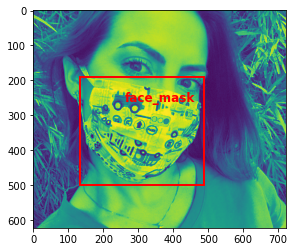

2559.png has 2 label(s)
['face_mask']


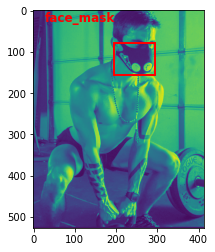

5342.jpg has 1 label(s)
[]


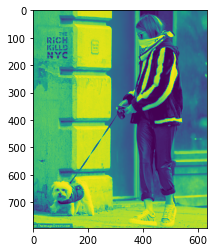

3919.png has 2 label(s)
['face_mask']


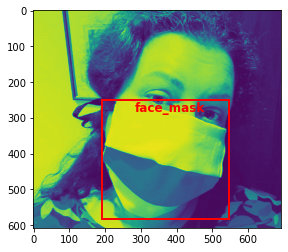

6254.jpg has 1 label(s)
[]


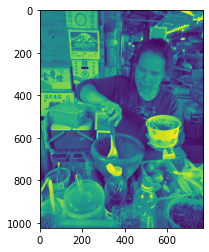

4985.png has 2 label(s)
['face_mask']


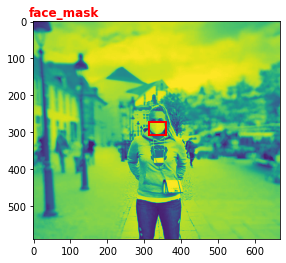

6282.jpg has 7 label(s)
[]


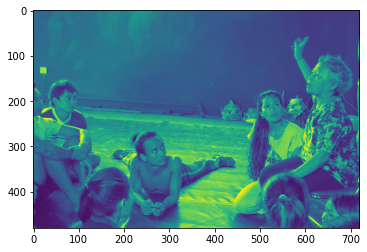

4879.png has 1 label(s)
[]


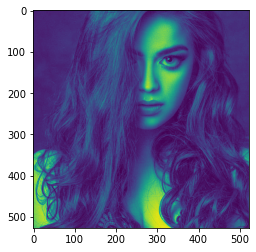

2583.png has 1 label(s)
[]


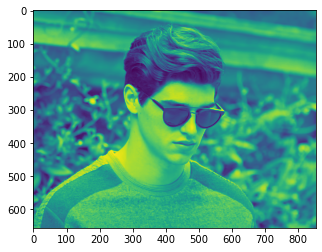

In [39]:
def plot_image_with_mask_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    img = cv2.imread(image_file_dir+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        # only include boxes for mask annotations
        if row['classname'] == 'face_mask':
            rect = patches.Rectangle(
                (row['x1'],row['x2']),
                row['y1'],
                row['y2'],
                linewidth=2,edgecolor='r',facecolor='none')
            ax.add_patch(rect)
            ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
            class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for f in list(set(train['name']))[0:20]:
    plot_image_with_mask_bboxes(f)







## Update Dataframe so it is consistend with other Dataset Annotations

In [40]:
train = train[['name','x1','x2','y1','y2','classname','image_file_dir']]

display(train)



,name,x1,x2,y1,y2,classname,image_file_dir
0,1801.jpg,451,186,444,511,face_no_mask,../Dataset/mask_image_data/images/
1,1802.jpg,160,151,108,114,face_mask,../Dataset/mask_image_data/images/
2,1802.jpg,110,71,163,201,face_with_mask,../Dataset/mask_image_data/images/
3,1803.jpg,147,200,141,120,face_mask,../Dataset/mask_image_data/images/
4,1803.jpg,126,75,177,258,face_with_mask,../Dataset/mask_image_data/images/
...,...,...,...,...,...,...,...
15407,6433.png,669,205,105,77,face_mask,../Dataset/mask_image_data/images/
15408,6434.jpg,315,82,460,701,face_with_mask,../Dataset/mask_image_data/images/
15409,6434.jpg,343,448,413,326,face_mask,../Dataset/mask_image_data/images/
15410,6435.jpg,198,86,94,63,face_mask,../Dataset/mask_image_data/images/


## Export annotation to a csv file



In [41]:
out_file = 'wobot_labels_km-annotated.csv'
train.to_csv(out_file,index=False)
print("Annotation File saved to:",out_file)



Annotation File saved to: wobot_labels_km-annotated.csv


<a id='ds3'></a>
## Dataset 3
#### Data obtained from:
# ????

In [42]:
import glob
image_data_dir = "../Dataset/mask_dataset/"
images = glob.glob(image_data_dir+"*.jpg")
annotations = glob.glob(image_data_dir+"*.txt")

print(len(images),"image files")
print(len(annotations),"annotation files")

print(images[0:10])

print(annotations[0:10])



631 image files
631 annotation files
['../Dataset/mask_dataset/ID9F5OP2GLJBVK864YSZ.jpg', '../Dataset/mask_dataset/7PB2UGCWRJ4EVKIM8HON.jpg', '../Dataset/mask_dataset/QU9MC483R6OWLAIEG75Y.jpg', '../Dataset/mask_dataset/MVQ6BC1ANRW3LX4PDH0G.jpg', '../Dataset/mask_dataset/MCU5X4PT23VYW8RA09EZ.jpg', '../Dataset/mask_dataset/KF9PE6DQ4LC2XISMNY0B.jpg', '../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg', '../Dataset/mask_dataset/0JCSNLB7FDORUP1ZHY8Q.jpg', '../Dataset/mask_dataset/3G06DNWVTZQ7JXCIPO1S.jpg', '../Dataset/mask_dataset/E485P1G6QMS97A3DVFOL.jpg']
['../Dataset/mask_dataset/XEU9HO5I78KFC6Z4Q1AG.txt', '../Dataset/mask_dataset/AL1503ZNDJ62HOWQYG7U.txt', '../Dataset/mask_dataset/D8G1QSLIATY5RMKE9W76.txt', '../Dataset/mask_dataset/H1UF8W04V6SILJOT3QXM.txt', '../Dataset/mask_dataset/JCD3IB0G8KYVOU9SA4FR.txt', '../Dataset/mask_dataset/GR43WB1XQZ7SVFYE98IA.txt', '../Dataset/mask_dataset/GV9IKM1UOXNW2B8L50TC.txt', '../Dataset/mask_dataset/4YNQDJGUPE18MRXZL7T2.txt', '../Dataset/mask_dataset/

Example Image


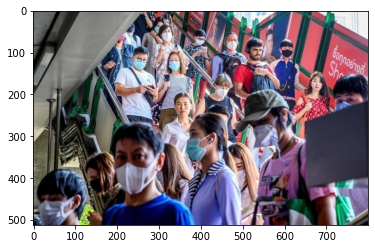

In [43]:
print("Example Image")
img=plt.imread(images[0])
plt.imshow(img)
plt.show()



In [44]:
# Reading annotations for data and put into a dataframe
data_ls = []

for fl in annotations:
    with open(fl,"r+") as f:
        data_ls.append([[fl.split("/")[-1].replace(".txt",".jpg")] + x.replace("\n","").split(' ') for x in f.readlines()])
    
data_ls

# flatten list
import functools
import operator

data_ls = functools.reduce(operator.iconcat, data_ls, [])

train = pd.DataFrame(data_ls)

train.columns = ['name','classname','x_center','y_center','width','height']
train.classname = train.classname.astype(int)
train.x_center = train['x_center'].astype(float)
train.y_center = train['y_center'].astype(float)
train.width = train['width'].astype(float)
train.height = train['height'].astype(float)

def convert_class_name(x):
    # 1 indicates no mask
    # 0 indicates mask
    if x == 1:
        return 'face_no_mask'
    if x == 0:
        return 'face_with_mask'

train.classname = train.classname.apply(lambda x: convert_class_name(x))

# reorder columns
train = train[['name','x_center','y_center','width','height','classname']]

# add file location to the dataframe
train['image_file_dir'] = len(train)*['../Dataset/mask_dataset/']

display(train)


,name,x_center,y_center,width,height,classname,image_file_dir
0,XEU9HO5I78KFC6Z4Q1AG.jpg,0.428906,0.404687,0.414062,0.276042,face_with_mask,../Dataset/mask_dataset/
1,AL1503ZNDJ62HOWQYG7U.jpg,0.529167,0.457222,0.541667,0.418889,face_with_mask,../Dataset/mask_dataset/
2,D8G1QSLIATY5RMKE9W76.jpg,0.559082,0.288889,0.110352,0.150000,face_with_mask,../Dataset/mask_dataset/
3,D8G1QSLIATY5RMKE9W76.jpg,0.516602,0.470139,0.085938,0.126389,face_with_mask,../Dataset/mask_dataset/
4,H1UF8W04V6SILJOT3QXM.jpg,0.841558,0.328333,0.080519,0.223333,face_with_mask,../Dataset/mask_dataset/
...,...,...,...,...,...,...,...
3096,KFT47WMN5GL9IVU2ZQSA.jpg,0.543125,0.558442,0.108750,0.141991,face_with_mask,../Dataset/mask_dataset/
3097,KFT47WMN5GL9IVU2ZQSA.jpg,0.672813,0.326407,0.121875,0.188745,face_with_mask,../Dataset/mask_dataset/
3098,SW6OGEH29AVUJZ7YLBPM.jpg,0.381500,0.484246,0.100000,0.162791,face_with_mask,../Dataset/mask_dataset/
3099,SW6OGEH29AVUJZ7YLBPM.jpg,0.594000,0.447112,0.087000,0.142536,face_with_mask,../Dataset/mask_dataset/


## NOTE: this dataset seems to only include face mask images, no negatives. This is okay we can use it still as it is fully labelled and annotated



In [45]:
set(train.classname) #{'face_no_mask', 'face_with_mask'}



{'face_with_mask'}

## Add bounding box to training set data

In [46]:

bbox=[]
for i in range(len(train)):
    arr=[]
    for j in train.iloc[i][['x_center','y_center','width','height']]:
        arr.append(j)
    bbox.append(arr)
train["bbox"]=bbox  

def get_boxes(id):
    boxes=[]
    for i in train[train["name"]==str(id)]["bbox"]:
        boxes.append(i)
    return boxes


display(train)



,name,x_center,y_center,width,height,classname,image_file_dir,bbox
0,XEU9HO5I78KFC6Z4Q1AG.jpg,0.428906,0.404687,0.414062,0.276042,face_with_mask,../Dataset/mask_dataset/,"[0.42890625, 0.4046875, 0.4140625, 0.276041666..."
1,AL1503ZNDJ62HOWQYG7U.jpg,0.529167,0.457222,0.541667,0.418889,face_with_mask,../Dataset/mask_dataset/,"[0.529166666667, 0.45722222222, 0.541666666667..."
2,D8G1QSLIATY5RMKE9W76.jpg,0.559082,0.288889,0.110352,0.150000,face_with_mask,../Dataset/mask_dataset/,"[0.55908203125, 0.288888888889, 0.1103515625, ..."
3,D8G1QSLIATY5RMKE9W76.jpg,0.516602,0.470139,0.085938,0.126389,face_with_mask,../Dataset/mask_dataset/,"[0.5166015625, 0.470138888889, 0.0859375, 0.12..."
4,H1UF8W04V6SILJOT3QXM.jpg,0.841558,0.328333,0.080519,0.223333,face_with_mask,../Dataset/mask_dataset/,"[0.841558441558, 0.328333333333, 0.08051948051..."
...,...,...,...,...,...,...,...,...
3096,KFT47WMN5GL9IVU2ZQSA.jpg,0.543125,0.558442,0.108750,0.141991,face_with_mask,../Dataset/mask_dataset/,"[0.543125, 0.55844155844, 0.10875, 0.141991341..."
3097,KFT47WMN5GL9IVU2ZQSA.jpg,0.672813,0.326407,0.121875,0.188745,face_with_mask,../Dataset/mask_dataset/,"[0.6728125, 0.326406926407, 0.121875, 0.188744..."
3098,SW6OGEH29AVUJZ7YLBPM.jpg,0.381500,0.484246,0.100000,0.162791,face_with_mask,../Dataset/mask_dataset/,"[0.3815, 0.484246061515, 0.1, 0.162790697674]"
3099,SW6OGEH29AVUJZ7YLBPM.jpg,0.594000,0.447112,0.087000,0.142536,face_with_mask,../Dataset/mask_dataset/,"[0.594, 0.447111777944, 0.087, 0.142535633908]"


## Show example training image with bounding box

../Dataset/mask_dataset/Q5PURTAXSEMDZ0OBKJY4.jpg
Rectangle(xy=(539, 98), width=87, height=105, angle=0)


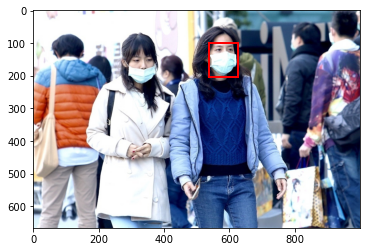

../Dataset/mask_dataset/SW6OGEH29AVUJZ7YLBPM.jpg
Rectangle(xy=(1101, 500), width=174, height=189, angle=0)


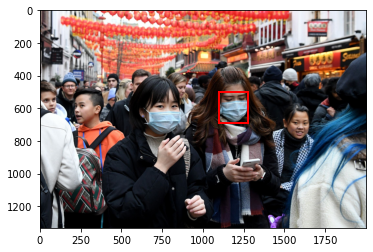

../Dataset/mask_dataset/SW6OGEH29AVUJZ7YLBPM.jpg
Rectangle(xy=(663, 536), width=200, height=216, angle=0)


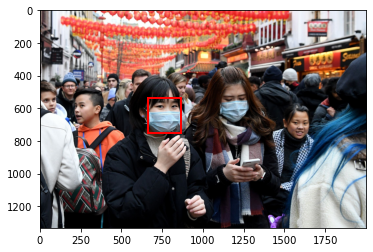

../Dataset/mask_dataset/AL1503ZNDJ62HOWQYG7U.jpg
Rectangle(xy=(155, 222), width=325, height=377, angle=0)


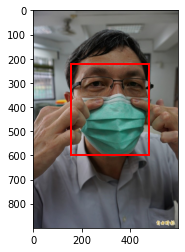

../Dataset/mask_dataset/D8G1QSLIATY5RMKE9W76.jpg
Rectangle(xy=(516, 154), width=113, height=108, angle=0)


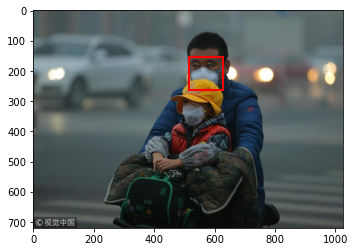

../Dataset/mask_dataset/D8G1QSLIATY5RMKE9W76.jpg
Rectangle(xy=(485, 293), width=88, height=91, angle=0)


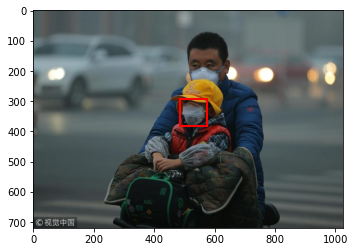

In [47]:
for index in [-1,-2,-3,1,2,3]:
    dat = train.iloc[index]
    image=dat['image_file_dir']+dat['name']

    print(image)
    img=plt.imread(image)

    fig,ax = plt.subplots(1)
    ax.imshow(img)
    box=dat.bbox

    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size

    rect = patches.Rectangle(
        (int((box[0]*img_width)-((box[2]/2)*img_width)),
        int((box[1]*img_height)-((box[3]/2)*img_height))),
        int((box[2])*img_width),
        int((box[3])*img_height),
        linewidth=2,edgecolor='r',facecolor='none'
    )
    print(rect)
    ax.add_patch(rect)
    plt.show()





### Convert bounding box coordinates to be consistent with other datasets

In [48]:
new_bbox = []

for i in range(len(train)):
    image='../Dataset/compiled_data/'+train.iloc[i]['name']#images[index]#images[index].split("/")[-1].replace(".txt",".jpg")
    img=plt.imread(image)
    img_width = img.shape[1]
    img_height = img.shape[0]
    # adjust bounding box to image size
    box=train.iloc[i].bbox
    
    new_box = [
#     int((box[2]*img_width)-((box[0]/2)*img_width)),
#     int((box[3]*img_height)-((box[1]/2)*img_height)),
#     int((box[0])*img_width),
#     int((box[1])*img_height)
    int((box[0]*img_width)-((box[2]/2)*img_width)),
    int((box[1]*img_height)-((box[3]/2)*img_height)),
    int((box[2])*img_width),
    int((box[3])*img_height)
    ]
    new_bbox.append(new_box)
    
train.bbox=new_bbox    
    

## Generate correctly name columns for bboxes

In [49]:
def get_x1(x):
    return x[0]

def get_x2(x):
    return x[1]

def get_y1(x):
    return x[2]

def get_y2(x):
    return x[3]

# convert bounding box to columns
train['x1']=train['bbox'].apply(lambda x: get_x1(x))
train['x2']=train['bbox'].apply(lambda x: get_x2(x))
train['y1']=train['bbox'].apply(lambda x: get_y1(x))
train['y2']=train['bbox'].apply(lambda x: get_y2(x))


display(train)



,name,x_center,y_center,width,height,classname,image_file_dir,bbox,x1,x2,y1,y2
0,XEU9HO5I78KFC6Z4Q1AG.jpg,0.428906,0.404687,0.414062,0.276042,face_with_mask,../Dataset/mask_dataset/,"[142, 255, 265, 265]",142,255,265,265
1,AL1503ZNDJ62HOWQYG7U.jpg,0.529167,0.457222,0.541667,0.418889,face_with_mask,../Dataset/mask_dataset/,"[155, 222, 325, 377]",155,222,325,377
2,D8G1QSLIATY5RMKE9W76.jpg,0.559082,0.288889,0.110352,0.150000,face_with_mask,../Dataset/mask_dataset/,"[516, 154, 113, 108]",516,154,113,108
3,D8G1QSLIATY5RMKE9W76.jpg,0.516602,0.470139,0.085938,0.126389,face_with_mask,../Dataset/mask_dataset/,"[485, 293, 88, 91]",485,293,88,91
4,H1UF8W04V6SILJOT3QXM.jpg,0.841558,0.328333,0.080519,0.223333,face_with_mask,../Dataset/mask_dataset/,"[1233, 129, 124, 133]",1233,129,124,133
...,...,...,...,...,...,...,...,...,...,...,...,...
3096,KFT47WMN5GL9IVU2ZQSA.jpg,0.543125,0.558442,0.108750,0.141991,face_with_mask,../Dataset/mask_dataset/,"[782, 562, 174, 163]",782,562,174,163
3097,KFT47WMN5GL9IVU2ZQSA.jpg,0.672813,0.326407,0.121875,0.188745,face_with_mask,../Dataset/mask_dataset/,"[979, 267, 195, 218]",979,267,195,218
3098,SW6OGEH29AVUJZ7YLBPM.jpg,0.381500,0.484246,0.100000,0.162791,face_with_mask,../Dataset/mask_dataset/,"[663, 536, 200, 216]",663,536,200,216
3099,SW6OGEH29AVUJZ7YLBPM.jpg,0.594000,0.447112,0.087000,0.142536,face_with_mask,../Dataset/mask_dataset/,"[1101, 500, 174, 189]",1101,500,174,189


## Plot some example boxes after updating the bbox values



BY4A9QUS5DWLV7ZRE0PO.jpg
BY4A9QUS5DWLV7ZRE0PO.jpg has 4 label(s)
120    ../Dataset/mask_dataset/BY4A9QUS5DWLV7ZRE0PO.jpg
121    ../Dataset/mask_dataset/BY4A9QUS5DWLV7ZRE0PO.jpg
122    ../Dataset/mask_dataset/BY4A9QUS5DWLV7ZRE0PO.jpg
123    ../Dataset/mask_dataset/BY4A9QUS5DWLV7ZRE0PO.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


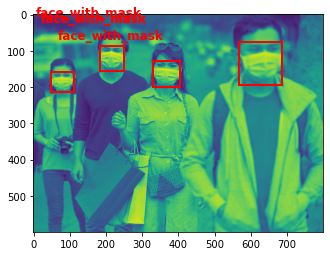

QMVKJXT2S4YIHZRGCAND.jpg
QMVKJXT2S4YIHZRGCAND.jpg has 1 label(s)
2111    ../Dataset/mask_dataset/QMVKJXT2S4YIHZRGCAND.jpg
Name: image_file_dir, dtype: object
['face_with_mask']


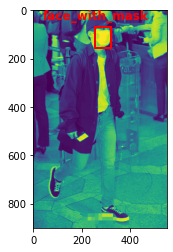

2XG9JKQUVBH5LYACMP06.jpg
2XG9JKQUVBH5LYACMP06.jpg has 1 label(s)
2403    ../Dataset/mask_dataset/2XG9JKQUVBH5LYACMP06.jpg
Name: image_file_dir, dtype: object
['face_with_mask']


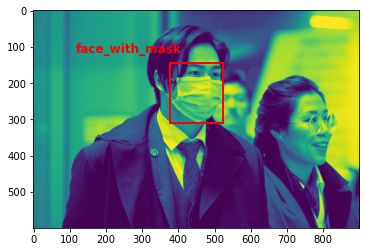

H8OTJNCIG7Z01F9QPW6K.jpg
H8OTJNCIG7Z01F9QPW6K.jpg has 6 label(s)
2785    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
2786    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
2787    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
2788    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
2789    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
2790    ../Dataset/mask_dataset/H8OTJNCIG7Z01F9QPW6K.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


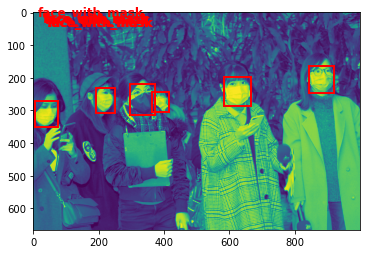

21LVBC8ZRXUW5MGEISNY.jpg
21LVBC8ZRXUW5MGEISNY.jpg has 5 label(s)
2423    ../Dataset/mask_dataset/21LVBC8ZRXUW5MGEISNY.jpg
2424    ../Dataset/mask_dataset/21LVBC8ZRXUW5MGEISNY.jpg
2425    ../Dataset/mask_dataset/21LVBC8ZRXUW5MGEISNY.jpg
2426    ../Dataset/mask_dataset/21LVBC8ZRXUW5MGEISNY.jpg
2427    ../Dataset/mask_dataset/21LVBC8ZRXUW5MGEISNY.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


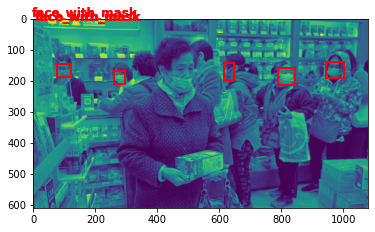

LF3NKSXJ9TOVPHDBC7G6.jpg
LF3NKSXJ9TOVPHDBC7G6.jpg has 4 label(s)
2611    ../Dataset/mask_dataset/LF3NKSXJ9TOVPHDBC7G6.jpg
2612    ../Dataset/mask_dataset/LF3NKSXJ9TOVPHDBC7G6.jpg
2613    ../Dataset/mask_dataset/LF3NKSXJ9TOVPHDBC7G6.jpg
2614    ../Dataset/mask_dataset/LF3NKSXJ9TOVPHDBC7G6.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


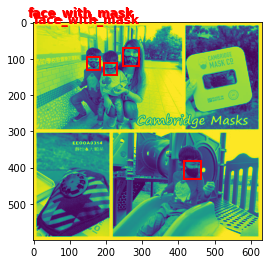

WINKAU59FBO718CX0RDH.jpg
WINKAU59FBO718CX0RDH.jpg has 14 label(s)
2673    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2674    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2675    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2676    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2677    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2678    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2679    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2680    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2681    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2682    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2683    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2684    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2685    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
2686    ../Dataset/mask_dataset/WINKAU59FBO718CX0RDH.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_wit

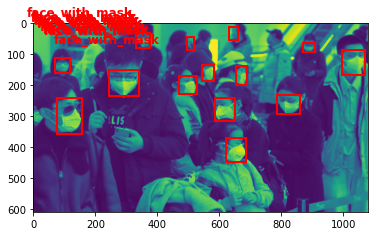

NM9ZHJU8I37OKAYDLRV0.jpg
NM9ZHJU8I37OKAYDLRV0.jpg has 9 label(s)
964    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
965    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
966    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
967    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
968    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
969    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
970    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
971    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
972    ../Dataset/mask_dataset/NM9ZHJU8I37OKAYDLRV0.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


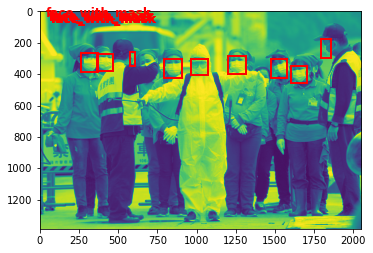

95VGE64TM7QCX1JPI3WF.jpg
95VGE64TM7QCX1JPI3WF.jpg has 2 label(s)
1959    ../Dataset/mask_dataset/95VGE64TM7QCX1JPI3WF.jpg
1960    ../Dataset/mask_dataset/95VGE64TM7QCX1JPI3WF.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask']


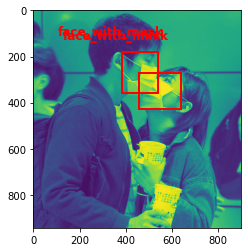

LH2FDC3WQX1JVR8E5NUG.jpg
LH2FDC3WQX1JVR8E5NUG.jpg has 1 label(s)
251    ../Dataset/mask_dataset/LH2FDC3WQX1JVR8E5NUG.jpg
Name: image_file_dir, dtype: object
['face_with_mask']


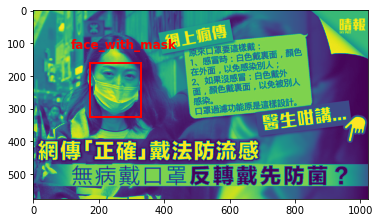

In [51]:
def plot_image_with_all_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for f in list(set(train['name']))[0:10]:
    print(f)
    plot_image_with_all_bboxes(f)






## Update Dataframe so it is consistend with other Dataset Annotations

In [52]:
train = train[['name','x1','x2','y1','y2','classname','image_file_dir']]

display(train)



,name,x1,x2,y1,y2,classname,image_file_dir
0,XEU9HO5I78KFC6Z4Q1AG.jpg,142,255,265,265,face_with_mask,../Dataset/mask_dataset/
1,AL1503ZNDJ62HOWQYG7U.jpg,155,222,325,377,face_with_mask,../Dataset/mask_dataset/
2,D8G1QSLIATY5RMKE9W76.jpg,516,154,113,108,face_with_mask,../Dataset/mask_dataset/
3,D8G1QSLIATY5RMKE9W76.jpg,485,293,88,91,face_with_mask,../Dataset/mask_dataset/
4,H1UF8W04V6SILJOT3QXM.jpg,1233,129,124,133,face_with_mask,../Dataset/mask_dataset/
...,...,...,...,...,...,...,...
3096,KFT47WMN5GL9IVU2ZQSA.jpg,782,562,174,163,face_with_mask,../Dataset/mask_dataset/
3097,KFT47WMN5GL9IVU2ZQSA.jpg,979,267,195,218,face_with_mask,../Dataset/mask_dataset/
3098,SW6OGEH29AVUJZ7YLBPM.jpg,663,536,200,216,face_with_mask,../Dataset/mask_dataset/
3099,SW6OGEH29AVUJZ7YLBPM.jpg,1101,500,174,189,face_with_mask,../Dataset/mask_dataset/


## Export annotation to a csv file



In [53]:
out_file = 'dataset3_labels_km-annotated.csv'
train.to_csv(out_file,index=False)
print("Annotation File saved to:",out_file)



Annotation File saved to: dataset3_labels_km-annotated.csv


<a id='ds4'></a>
## Dataset 4
#### Data obtained from:
https://www.kaggle.com/andrewmvd/face-mask-detection

    

In [54]:
import glob

image_file_dir = "../Dataset/dataset_4/images/"
images = glob.glob(image_file_dir+"*.png")
annotations = glob.glob("../Dataset/dataset_4/annotations/*.xml")

print(len(images),"image files")
print(len(annotations),"annotations files")


853 image files
853 annotations files


Example Image


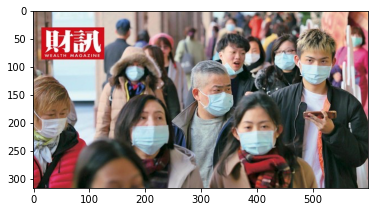

In [55]:
print("Example Image")
img=plt.imread(images[0])
plt.imshow(img)
plt.show()



### Compile Annotations into a dataframe

In [56]:
import os
import xml.etree.ElementTree as et
import re
import pandas as pd

data = []
for file in os.listdir("../Dataset/dataset_4/annotations"):
    xml = et.parse("../Dataset/dataset_4/annotations/"+file) 
    root = xml.getroot()
    img = root[1].text # image name
    
#     row.append(img)
#     h,w = root[2][0].text,root[2][1].text # height and width
#     row.append([h,w])

    for i in range(4,len(root)):
        temp = []
        temp.append(root[i][0].text)
        for point in root[i][5]:
            temp.append(point.text)
        data.append([img]+ temp)
        
train = pd.DataFrame(data)    
train.columns=['name','classname','x1','x2','y1','y2']
train = train[['name','x1','x2','y1','y2','classname']]
train

# name	x_center	y_center	width	height	classnam
# name	x1	x2	y1	y2	classname

train.x1 = train['x1'].astype(int)
train.x2 = train['x2'].astype(int)
train.y1 = train['y1'].astype(int)
train.y2 = train['y2'].astype(int)

# add column for image file directory
train['image_file_dir'] = len(train)*[image_file_dir]
display(train)




,name,x1,x2,y1,y2,classname,image_file_dir
0,maksssksksss299.png,62,194,160,320,without_mask,../Dataset/dataset_4/images/
1,maksssksksss528.png,43,169,149,308,without_mask,../Dataset/dataset_4/images/
2,maksssksksss272.png,48,107,218,304,mask_weared_incorrect,../Dataset/dataset_4/images/
3,maksssksksss514.png,28,78,43,99,with_mask,../Dataset/dataset_4/images/
4,maksssksksss514.png,160,66,176,83,with_mask,../Dataset/dataset_4/images/
...,...,...,...,...,...,...,...
4067,maksssksksss294.png,271,73,278,82,without_mask,../Dataset/dataset_4/images/
4068,maksssksksss294.png,236,91,243,99,without_mask,../Dataset/dataset_4/images/
4069,maksssksksss294.png,236,76,243,83,without_mask,../Dataset/dataset_4/images/
4070,maksssksksss294.png,264,76,268,82,with_mask,../Dataset/dataset_4/images/


In [57]:
# add bounding box to training set data
bbox=[]
for i in range(len(train)):
    arr=[]
    for j in train.iloc[i][['x1','x2','y1','y2']]:
        arr.append(j)
#     bbox.append(arr)
    bbox.append([arr[0],arr[1],arr[2]-arr[0],arr[3]-arr[1]])# Renumber bounding boxes to match other datasets


train["bbox"]=bbox  

def get_boxes(id):
    boxes=[]
    for i in train[train["name"]==str(id)]["bbox"]:
        boxes.append(i)
    return boxes


display(train)

,name,x1,x2,y1,y2,classname,image_file_dir,bbox
0,maksssksksss299.png,62,194,160,320,without_mask,../Dataset/dataset_4/images/,"[62, 194, 98, 126]"
1,maksssksksss528.png,43,169,149,308,without_mask,../Dataset/dataset_4/images/,"[43, 169, 106, 139]"
2,maksssksksss272.png,48,107,218,304,mask_weared_incorrect,../Dataset/dataset_4/images/,"[48, 107, 170, 197]"
3,maksssksksss514.png,28,78,43,99,with_mask,../Dataset/dataset_4/images/,"[28, 78, 15, 21]"
4,maksssksksss514.png,160,66,176,83,with_mask,../Dataset/dataset_4/images/,"[160, 66, 16, 17]"
...,...,...,...,...,...,...,...,...
4067,maksssksksss294.png,271,73,278,82,without_mask,../Dataset/dataset_4/images/,"[271, 73, 7, 9]"
4068,maksssksksss294.png,236,91,243,99,without_mask,../Dataset/dataset_4/images/,"[236, 91, 7, 8]"
4069,maksssksksss294.png,236,76,243,83,without_mask,../Dataset/dataset_4/images/,"[236, 76, 7, 7]"
4070,maksssksksss294.png,264,76,268,82,with_mask,../Dataset/dataset_4/images/,"[264, 76, 4, 6]"


## Classify Data

In [58]:
set(train.classname) 


{'mask_weared_incorrect', 'with_mask', 'without_mask'}

### Update labels to match other datasets

In [59]:
# convert class names to match other datasets

def convert_class_name(x):
    # 1 indicates no mask
    # 0 indicates mask
    if x == 'without_mask':
        return 'face_no_mask'
    if x == 'with_mask':
        return 'face_with_mask'
    if x == 'mask_weared_incorrect':
        return 'face_with_mask'# TODO: in future could change back to'face_with_mask_incorrect'

train.classname = train.classname.apply(lambda x: convert_class_name(x))

set(train.classname) 



{'face_no_mask', 'face_with_mask'}

### Show example training image with bounding box

maksssksksss702.png
[[9, 170, 51, 59], [165, 90, 37, 34], [175, 175, 69, 85], [303, 127, 57, 64], [340, 66, 40, 45], [379, 63, 29, 35], [433, 61, 38, 44], [477, 78, 59, 55], [569, 37, 23, 30], [367, 192, 70, 67], [221, 57, 27, 24]]


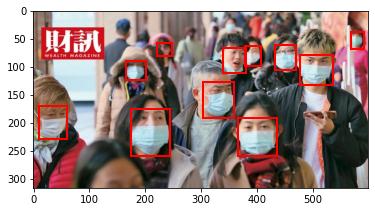

In [60]:

index = 18
image=train.iloc[index]['name']
print(image)
img=plt.imread('../Dataset/dataset_4/images/'+image)


fig,ax = plt.subplots(1)
ax.imshow(img)
boxes=list(train[train.name == image]['bbox'])
print(boxes)
for box in boxes:
    rect = patches.Rectangle((box[0],box[1]),box[2],box[3],linewidth=2,edgecolor='r',facecolor='none')
#     rect = patches.Rectangle((box[0],box[1]),box[2]-box[0],box[3]-box[1],linewidth=2,edgecolor='r',facecolor='none')
    ax.add_patch(rect)
plt.show()


## Generate correctly name columns for bboxes
# NOTE: the y1 and y2 columns DO NOT MATCH corresponding values from bbox which is why were are updating them here

In [61]:
def get_x1(x):
    return x[0]

def get_x2(x):
    return x[1]

def get_y1(x):
    return x[2]

def get_y2(x):
    return x[3]

# convert bounding box to columns
train['x1']=train['bbox'].apply(lambda x: get_x1(x))
train['x2']=train['bbox'].apply(lambda x: get_x2(x))
train['y1']=train['bbox'].apply(lambda x: get_y1(x))
train['y2']=train['bbox'].apply(lambda x: get_y2(x))


display(train)



,name,x1,x2,y1,y2,classname,image_file_dir,bbox
0,maksssksksss299.png,62,194,98,126,face_no_mask,../Dataset/dataset_4/images/,"[62, 194, 98, 126]"
1,maksssksksss528.png,43,169,106,139,face_no_mask,../Dataset/dataset_4/images/,"[43, 169, 106, 139]"
2,maksssksksss272.png,48,107,170,197,face_with_mask,../Dataset/dataset_4/images/,"[48, 107, 170, 197]"
3,maksssksksss514.png,28,78,15,21,face_with_mask,../Dataset/dataset_4/images/,"[28, 78, 15, 21]"
4,maksssksksss514.png,160,66,16,17,face_with_mask,../Dataset/dataset_4/images/,"[160, 66, 16, 17]"
...,...,...,...,...,...,...,...,...
4067,maksssksksss294.png,271,73,7,9,face_no_mask,../Dataset/dataset_4/images/,"[271, 73, 7, 9]"
4068,maksssksksss294.png,236,91,7,8,face_no_mask,../Dataset/dataset_4/images/,"[236, 91, 7, 8]"
4069,maksssksksss294.png,236,76,7,7,face_no_mask,../Dataset/dataset_4/images/,"[236, 76, 7, 7]"
4070,maksssksksss294.png,264,76,4,6,face_with_mask,../Dataset/dataset_4/images/,"[264, 76, 4, 6]"


## Plot some example boxes after updating the bbox values



maksssksksss434.png
maksssksksss434.png has 1 label(s)
2336    ../Dataset/dataset_4/images/maksssksksss434.png
Name: image_file_dir, dtype: object
['face_with_mask']


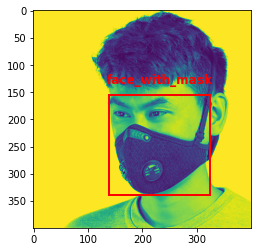

maksssksksss392.png
maksssksksss392.png has 1 label(s)
2069    ../Dataset/dataset_4/images/maksssksksss392.png
Name: image_file_dir, dtype: object
['face_with_mask']


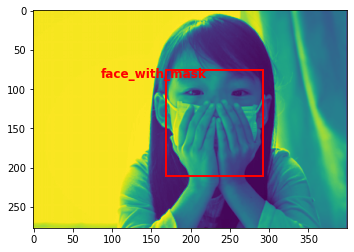

maksssksksss314.png
maksssksksss314.png has 9 label(s)
523    ../Dataset/dataset_4/images/maksssksksss314.png
524    ../Dataset/dataset_4/images/maksssksksss314.png
525    ../Dataset/dataset_4/images/maksssksksss314.png
526    ../Dataset/dataset_4/images/maksssksksss314.png
527    ../Dataset/dataset_4/images/maksssksksss314.png
528    ../Dataset/dataset_4/images/maksssksksss314.png
529    ../Dataset/dataset_4/images/maksssksksss314.png
530    ../Dataset/dataset_4/images/maksssksksss314.png
531    ../Dataset/dataset_4/images/maksssksksss314.png
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


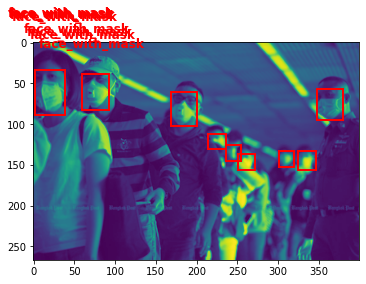

maksssksksss306.png
maksssksksss306.png has 1 label(s)
95    ../Dataset/dataset_4/images/maksssksksss306.png
Name: image_file_dir, dtype: object
['face_with_mask']


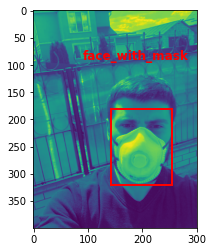

maksssksksss303.png
maksssksksss303.png has 2 label(s)
749    ../Dataset/dataset_4/images/maksssksksss303.png
750    ../Dataset/dataset_4/images/maksssksksss303.png
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask']


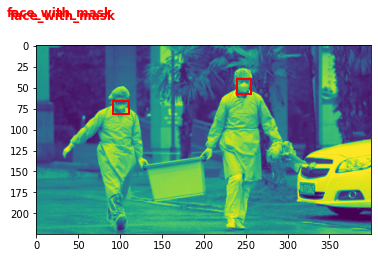

maksssksksss837.png
maksssksksss837.png has 1 label(s)
1688    ../Dataset/dataset_4/images/maksssksksss837.png
Name: image_file_dir, dtype: object
['face_no_mask']


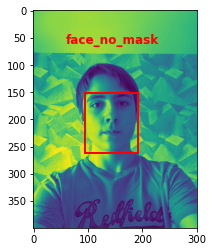

maksssksksss538.png
maksssksksss538.png has 3 label(s)
836    ../Dataset/dataset_4/images/maksssksksss538.png
837    ../Dataset/dataset_4/images/maksssksksss538.png
838    ../Dataset/dataset_4/images/maksssksksss538.png
Name: image_file_dir, dtype: object
['face_no_mask', 'face_with_mask', 'face_with_mask']


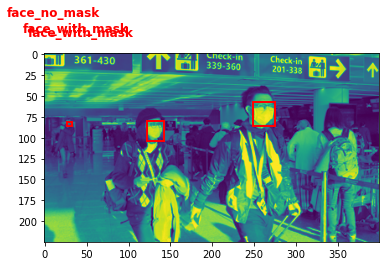

maksssksksss46.png
maksssksksss46.png has 10 label(s)
1727    ../Dataset/dataset_4/images/maksssksksss46.png
1728    ../Dataset/dataset_4/images/maksssksksss46.png
1729    ../Dataset/dataset_4/images/maksssksksss46.png
1730    ../Dataset/dataset_4/images/maksssksksss46.png
1731    ../Dataset/dataset_4/images/maksssksksss46.png
1732    ../Dataset/dataset_4/images/maksssksksss46.png
1733    ../Dataset/dataset_4/images/maksssksksss46.png
1734    ../Dataset/dataset_4/images/maksssksksss46.png
1735    ../Dataset/dataset_4/images/maksssksksss46.png
1736    ../Dataset/dataset_4/images/maksssksksss46.png
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


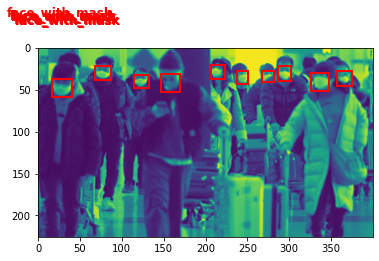

maksssksksss754.png
maksssksksss754.png has 4 label(s)
1950    ../Dataset/dataset_4/images/maksssksksss754.png
1951    ../Dataset/dataset_4/images/maksssksksss754.png
1952    ../Dataset/dataset_4/images/maksssksksss754.png
1953    ../Dataset/dataset_4/images/maksssksksss754.png
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


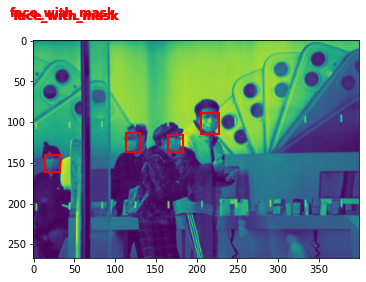

maksssksksss325.png
maksssksksss325.png has 11 label(s)
3324    ../Dataset/dataset_4/images/maksssksksss325.png
3325    ../Dataset/dataset_4/images/maksssksksss325.png
3326    ../Dataset/dataset_4/images/maksssksksss325.png
3327    ../Dataset/dataset_4/images/maksssksksss325.png
3328    ../Dataset/dataset_4/images/maksssksksss325.png
3329    ../Dataset/dataset_4/images/maksssksksss325.png
3330    ../Dataset/dataset_4/images/maksssksksss325.png
3331    ../Dataset/dataset_4/images/maksssksksss325.png
3332    ../Dataset/dataset_4/images/maksssksksss325.png
3333    ../Dataset/dataset_4/images/maksssksksss325.png
3334    ../Dataset/dataset_4/images/maksssksksss325.png
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_no_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask']


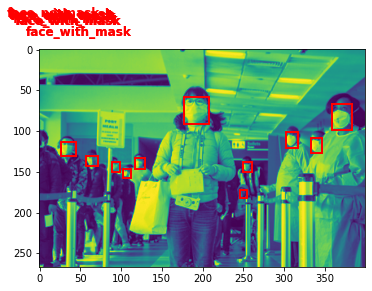

In [62]:
def plot_image_with_all_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for f in list(set(train['name']))[0:10]:
    print(f)
    plot_image_with_all_bboxes(f)






## Update Dataframe so it is consistend with other Dataset Annotations

In [63]:
train = train[['name','x1','x2','y1','y2','classname','image_file_dir']]

display(train)



,name,x1,x2,y1,y2,classname,image_file_dir
0,maksssksksss299.png,62,194,98,126,face_no_mask,../Dataset/dataset_4/images/
1,maksssksksss528.png,43,169,106,139,face_no_mask,../Dataset/dataset_4/images/
2,maksssksksss272.png,48,107,170,197,face_with_mask,../Dataset/dataset_4/images/
3,maksssksksss514.png,28,78,15,21,face_with_mask,../Dataset/dataset_4/images/
4,maksssksksss514.png,160,66,16,17,face_with_mask,../Dataset/dataset_4/images/
...,...,...,...,...,...,...,...
4067,maksssksksss294.png,271,73,7,9,face_no_mask,../Dataset/dataset_4/images/
4068,maksssksksss294.png,236,91,7,8,face_no_mask,../Dataset/dataset_4/images/
4069,maksssksksss294.png,236,76,7,7,face_no_mask,../Dataset/dataset_4/images/
4070,maksssksksss294.png,264,76,4,6,face_with_mask,../Dataset/dataset_4/images/


## Export annotation to a csv file



In [64]:
out_file = 'dataset4_labels_km-annotated.csv'
train.to_csv(out_file,index=False)
print("Annotation File saved to:",out_file)



Annotation File saved to: dataset4_labels_km-annotated.csv


<a id='ds5'></a>
## Dataset 5
#### Data obtained from:
https://github.com/cabani/MaskedFace-Net
# TODO: this dataset is too large and I cannot determine how to download it successfully
    

<a id='comp'></a>
# Compiled Dataset
Load in each annotation file

In [85]:
annotation_file_ls = ['wobot_labels_km-annotated.csv', 'dataset3_labels_km-annotated.csv', 'dataset4_labels_km-annotated.csv', 'yolo_labels_km-annotated.csv']
compiled = pd.DataFrame(columns = ['name', 'x1', 'x2', 'y1', 'y2', 'classname', 'image_file_dir'])
n = 0
for f in annotation_file_ls:
    compiled = pd.concat([compiled,pd.read_csv(f)])
    print(f,'has',len(pd.read_csv(f)),'annotations')
    n+=len(pd.read_csv(f))
display(compiled)
print("All data added:",len(compiled)==n)


wobot_labels_km-annotated.csv has 11577 annotations
dataset3_labels_km-annotated.csv has 3101 annotations
dataset4_labels_km-annotated.csv has 4072 annotations
yolo_labels_km-annotated.csv has 1567 annotations


,name,x1,x2,y1,y2,classname,image_file_dir
0,1801.jpg,451,186,444,511,face_no_mask,../Dataset/mask_image_data/images/
1,1802.jpg,160,151,108,114,face_mask,../Dataset/mask_image_data/images/
2,1802.jpg,110,71,163,201,face_with_mask,../Dataset/mask_image_data/images/
3,1803.jpg,147,200,141,120,face_mask,../Dataset/mask_image_data/images/
4,1803.jpg,126,75,177,258,face_with_mask,../Dataset/mask_image_data/images/
...,...,...,...,...,...,...,...
1562,new_76.jpg,191,187,282,382,face_no_mask,../Dataset/yolo/images/valid/
1563,new_78.jpg,126,200,335,370,face_no_mask,../Dataset/yolo/images/valid/
1564,new_79.jpg,138,212,305,332,face_no_mask,../Dataset/yolo/images/valid/
1565,new_90.jpg,133,263,346,316,face_no_mask,../Dataset/yolo/images/valid/


All data added: True


# Plot some image annotations (at least one from each dataset)

../Dataset/dataset_4/images/ maksssksksss299.png
maksssksksss299.png has 1 label(s)
0    ../Dataset/dataset_4/images/maksssksksss299.png
Name: image_file_dir, dtype: object
['face_no_mask']


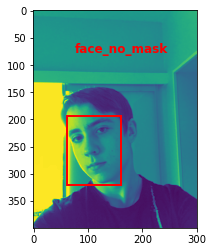





../Dataset/dataset_4/images/ maksssksksss528.png
maksssksksss528.png has 1 label(s)
1    ../Dataset/dataset_4/images/maksssksksss528.png
Name: image_file_dir, dtype: object
['face_no_mask']


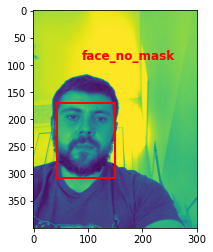





../Dataset/yolo/images/train/ 10.jpg
10.jpg has 1 label(s)
0    ../Dataset/yolo/images/train/10.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


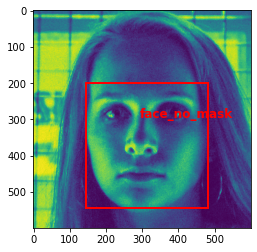





../Dataset/yolo/images/train/ 100.jpg
100.jpg has 2 label(s)
1       ../Dataset/yolo/images/train/100.jpg
1206    ../Dataset/yolo/images/valid/100.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask']


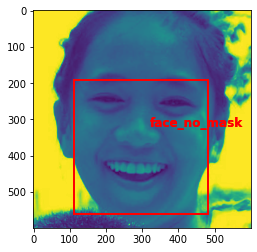





../Dataset/mask_dataset/ XEU9HO5I78KFC6Z4Q1AG.jpg
XEU9HO5I78KFC6Z4Q1AG.jpg has 1 label(s)
0    ../Dataset/mask_dataset/XEU9HO5I78KFC6Z4Q1AG.jpg
Name: image_file_dir, dtype: object
['face_with_mask']


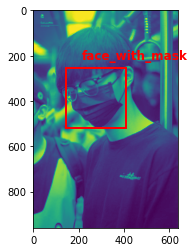





../Dataset/mask_dataset/ AL1503ZNDJ62HOWQYG7U.jpg
AL1503ZNDJ62HOWQYG7U.jpg has 1 label(s)
1    ../Dataset/mask_dataset/AL1503ZNDJ62HOWQYG7U.jpg
Name: image_file_dir, dtype: object
['face_with_mask']


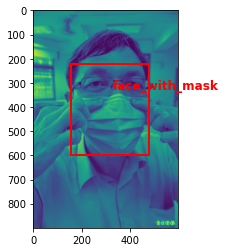





../Dataset/yolo/images/valid/ 100.jpg
100.jpg has 2 label(s)
1       ../Dataset/yolo/images/train/100.jpg
1206    ../Dataset/yolo/images/valid/100.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask']


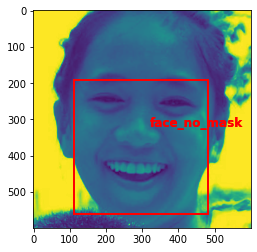





../Dataset/yolo/images/valid/ 107.jpg
107.jpg has 2 label(s)
7       ../Dataset/yolo/images/train/107.jpg
1207    ../Dataset/yolo/images/valid/107.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask']


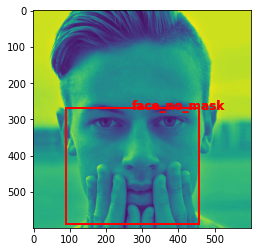





../Dataset/mask_image_data/images/ 1801.jpg
1801.jpg has 1 label(s)
0    ../Dataset/mask_image_data/images/1801.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


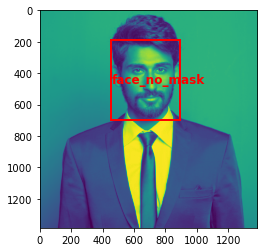





../Dataset/mask_image_data/images/ 1802.jpg
1802.jpg has 2 label(s)
1    ../Dataset/mask_image_data/images/1802.jpg
2    ../Dataset/mask_image_data/images/1802.jpg
Name: image_file_dir, dtype: object
['face_mask', 'face_with_mask']


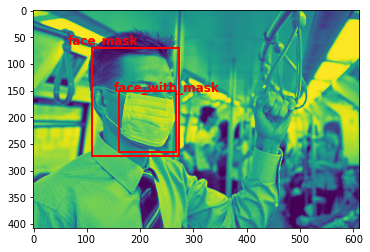

In [103]:
data_source_ls = list(set(compiled['image_file_dir'] ))# will be different for each dataset

# get two images from each data source
name_ls = []
for d in data_source_ls:
    name_ls.append(compiled[compiled['image_file_dir'] == d].iloc[0]['name'])
    name_ls.append(compiled[compiled['image_file_dir'] == d].iloc[1]['name'])

def plot_image_with_all_bboxes(img_nm):
    dat = compiled[compiled['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    
    
for i in range(len(name_ls)):
    print(data_source_ls[int(i/2)],name_ls[i])
    plot_image_with_all_bboxes(name_ls[i])
    print("\n\n\n")




# Plot compiled training data distribution



face_with_mask         11767
face_mask               4306
face_no_mask            2872
face_other_covering     1372
Name: classname, dtype: int64


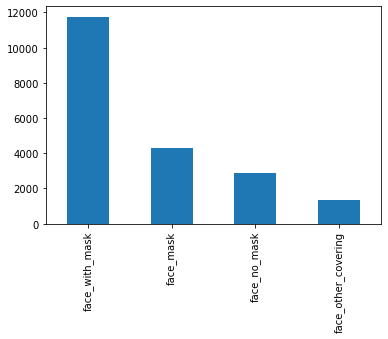

In [104]:
compiled.classname.value_counts().plot(kind='bar')
print(compiled.classname.value_counts())



# Plot some mask only images to ensure labels are correct

4549.png has 2 label(s)
7597    ../Dataset/mask_image_data/images/4549.png
7598    ../Dataset/mask_image_data/images/4549.png
Name: image_file_dir, dtype: object
['face_mask']


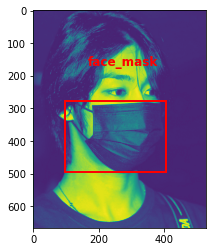

4578.png has 2 label(s)
7690    ../Dataset/mask_image_data/images/4578.png
7691    ../Dataset/mask_image_data/images/4578.png
Name: image_file_dir, dtype: object
['face_mask']


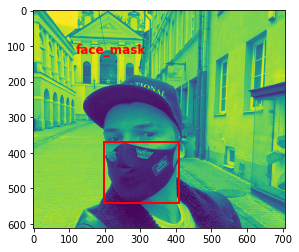

4655.png has 5 label(s)
7925    ../Dataset/mask_image_data/images/4655.png
7926    ../Dataset/mask_image_data/images/4655.png
7927    ../Dataset/mask_image_data/images/4655.png
7928    ../Dataset/mask_image_data/images/4655.png
7929    ../Dataset/mask_image_data/images/4655.png
Name: image_file_dir, dtype: object
['face_mask']


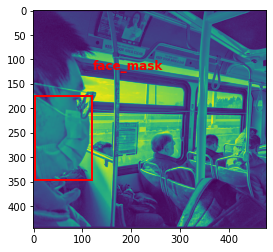

3861.png has 7 label(s)
5573    ../Dataset/mask_image_data/images/3861.png
5574    ../Dataset/mask_image_data/images/3861.png
5575    ../Dataset/mask_image_data/images/3861.png
5576    ../Dataset/mask_image_data/images/3861.png
5577    ../Dataset/mask_image_data/images/3861.png
5578    ../Dataset/mask_image_data/images/3861.png
5579    ../Dataset/mask_image_data/images/3861.png
Name: image_file_dir, dtype: object
['face_mask']


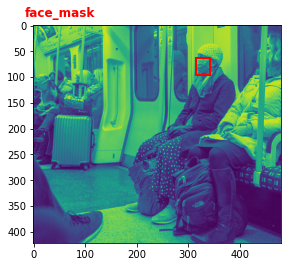

4084.png has 4 label(s)
6296    ../Dataset/mask_image_data/images/4084.png
6297    ../Dataset/mask_image_data/images/4084.png
6298    ../Dataset/mask_image_data/images/4084.png
6299    ../Dataset/mask_image_data/images/4084.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask']


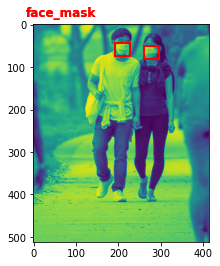

3582.png has 4 label(s)
4727    ../Dataset/mask_image_data/images/3582.png
4728    ../Dataset/mask_image_data/images/3582.png
4729    ../Dataset/mask_image_data/images/3582.png
4730    ../Dataset/mask_image_data/images/3582.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask']


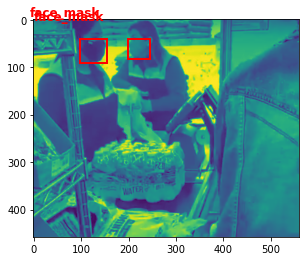

3524.png has 10 label(s)
4593    ../Dataset/mask_image_data/images/3524.png
4594    ../Dataset/mask_image_data/images/3524.png
4595    ../Dataset/mask_image_data/images/3524.png
4596    ../Dataset/mask_image_data/images/3524.png
4597    ../Dataset/mask_image_data/images/3524.png
4598    ../Dataset/mask_image_data/images/3524.png
4599    ../Dataset/mask_image_data/images/3524.png
4600    ../Dataset/mask_image_data/images/3524.png
4601    ../Dataset/mask_image_data/images/3524.png
4602    ../Dataset/mask_image_data/images/3524.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask', 'face_mask', 'face_mask']


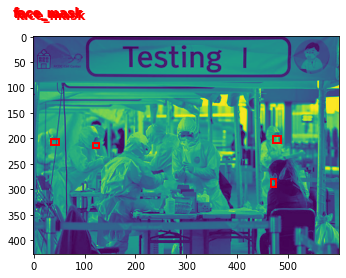

3340.png has 2 label(s)
4051    ../Dataset/mask_image_data/images/3340.png
4052    ../Dataset/mask_image_data/images/3340.png
Name: image_file_dir, dtype: object
['face_mask']


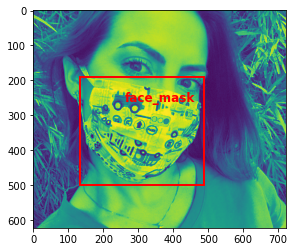

2559.png has 2 label(s)
2087    ../Dataset/mask_image_data/images/2559.png
2088    ../Dataset/mask_image_data/images/2559.png
Name: image_file_dir, dtype: object
['face_mask']


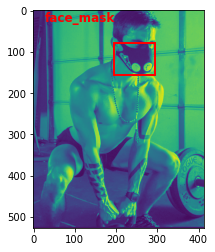

3919.png has 2 label(s)
5769    ../Dataset/mask_image_data/images/3919.png
5770    ../Dataset/mask_image_data/images/3919.png
Name: image_file_dir, dtype: object
['face_mask']


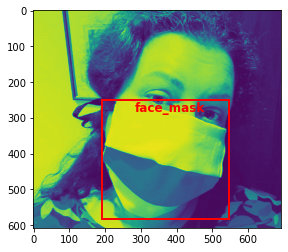

4985.png has 2 label(s)
8838    ../Dataset/mask_image_data/images/4985.png
8839    ../Dataset/mask_image_data/images/4985.png
Name: image_file_dir, dtype: object
['face_mask']


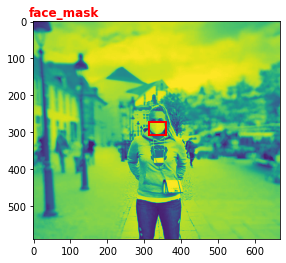

2903.png has 2 label(s)
2924    ../Dataset/mask_image_data/images/2903.png
2925    ../Dataset/mask_image_data/images/2903.png
Name: image_file_dir, dtype: object
['face_mask']


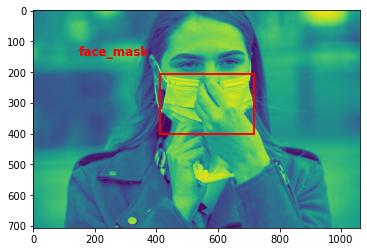

4838.png has 2 label(s)
8468    ../Dataset/mask_image_data/images/4838.png
8469    ../Dataset/mask_image_data/images/4838.png
Name: image_file_dir, dtype: object
['face_mask']


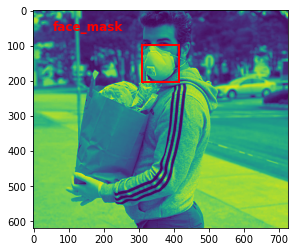

5445.jpg has 4 label(s)
9967    ../Dataset/mask_image_data/images/5445.jpg
9968    ../Dataset/mask_image_data/images/5445.jpg
9969    ../Dataset/mask_image_data/images/5445.jpg
9970    ../Dataset/mask_image_data/images/5445.jpg
Name: image_file_dir, dtype: object
['face_mask', 'face_mask']


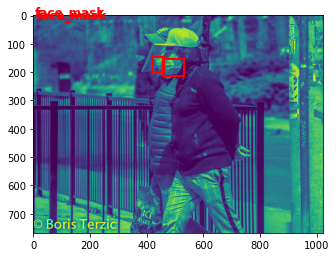

3509.png has 4 label(s)
4537    ../Dataset/mask_image_data/images/3509.png
4538    ../Dataset/mask_image_data/images/3509.png
4539    ../Dataset/mask_image_data/images/3509.png
4540    ../Dataset/mask_image_data/images/3509.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask']


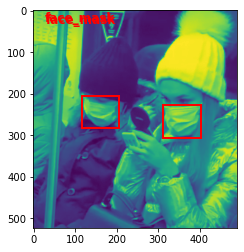

2269.png has 2 label(s)
1290    ../Dataset/mask_image_data/images/2269.png
1291    ../Dataset/mask_image_data/images/2269.png
Name: image_file_dir, dtype: object
['face_mask']


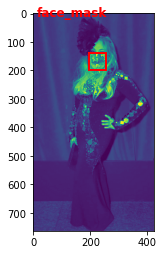

4566.png has 6 label(s)
7654    ../Dataset/mask_image_data/images/4566.png
7655    ../Dataset/mask_image_data/images/4566.png
7656    ../Dataset/mask_image_data/images/4566.png
7657    ../Dataset/mask_image_data/images/4566.png
7658    ../Dataset/mask_image_data/images/4566.png
7659    ../Dataset/mask_image_data/images/4566.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask', 'face_mask']


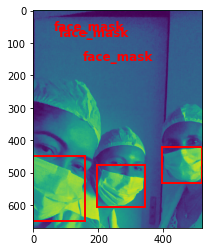

4682.png has 16 label(s)
8005    ../Dataset/mask_image_data/images/4682.png
8006    ../Dataset/mask_image_data/images/4682.png
8007    ../Dataset/mask_image_data/images/4682.png
8008    ../Dataset/mask_image_data/images/4682.png
8009    ../Dataset/mask_image_data/images/4682.png
8010    ../Dataset/mask_image_data/images/4682.png
8011    ../Dataset/mask_image_data/images/4682.png
8012    ../Dataset/mask_image_data/images/4682.png
8013    ../Dataset/mask_image_data/images/4682.png
8014    ../Dataset/mask_image_data/images/4682.png
8015    ../Dataset/mask_image_data/images/4682.png
8016    ../Dataset/mask_image_data/images/4682.png
8017    ../Dataset/mask_image_data/images/4682.png
8018    ../Dataset/mask_image_data/images/4682.png
8019    ../Dataset/mask_image_data/images/4682.png
8020    ../Dataset/mask_image_data/images/4682.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask', 'face_mask', 'face_mask', 'face_mask', 'face_mask', 'face_mask', 'face_mask']


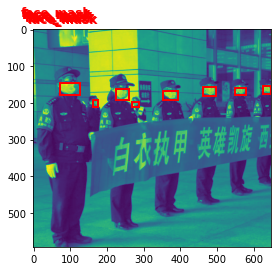

2763.png has 2 label(s)
2589    ../Dataset/mask_image_data/images/2763.png
2590    ../Dataset/mask_image_data/images/2763.png
Name: image_file_dir, dtype: object
['face_mask']


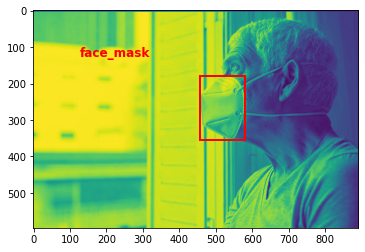

4176.png has 6 label(s)
6567    ../Dataset/mask_image_data/images/4176.png
6568    ../Dataset/mask_image_data/images/4176.png
6569    ../Dataset/mask_image_data/images/4176.png
6570    ../Dataset/mask_image_data/images/4176.png
6571    ../Dataset/mask_image_data/images/4176.png
6572    ../Dataset/mask_image_data/images/4176.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask', 'face_mask']


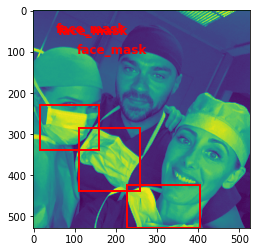

In [112]:
# get list of file names of with just masks
mask_file_names = list(set(compiled[compiled['classname'] == 'face_mask']['name']))

def plot_image_with_mask_bboxes(img_nm):
    
    dat = compiled[compiled['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        # only include boxes for mask annotations
        if row['classname'] == 'face_mask':
            rect = patches.Rectangle(
                (row['x1'],row['x2']),
                row['y1'],
                row['y2'],
                linewidth=2,edgecolor='r',facecolor='none')
            ax.add_patch(rect)
            ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
            class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
    


for m in mask_file_names[0:20]:
    plot_image_with_mask_bboxes(m)



## Export Compiled annotation to a csv file



In [113]:
out_file = 'compiled_labels_km-annotated.csv'
compiled.to_csv(out_file,index=False)
print("Annotation File saved to:",out_file)



Annotation File saved to: compiled_labels_km-annotated.csv


# Test reading in compiled annotation file

In [115]:
train = pd.read_csv('compiled_labels_km-annotated.csv')

display(train)


,name,x1,x2,y1,y2,classname,image_file_dir
0,1801.jpg,451,186,444,511,face_no_mask,../Dataset/mask_image_data/images/
1,1802.jpg,160,151,108,114,face_mask,../Dataset/mask_image_data/images/
2,1802.jpg,110,71,163,201,face_with_mask,../Dataset/mask_image_data/images/
3,1803.jpg,147,200,141,120,face_mask,../Dataset/mask_image_data/images/
4,1803.jpg,126,75,177,258,face_with_mask,../Dataset/mask_image_data/images/
...,...,...,...,...,...,...,...
20312,new_76.jpg,191,187,282,382,face_no_mask,../Dataset/yolo/images/valid/
20313,new_78.jpg,126,200,335,370,face_no_mask,../Dataset/yolo/images/valid/
20314,new_79.jpg,138,212,305,332,face_no_mask,../Dataset/yolo/images/valid/
20315,new_90.jpg,133,263,346,316,face_no_mask,../Dataset/yolo/images/valid/


# Plot All Annotations

6070.jpg has 1 label(s)
10814    ../Dataset/mask_image_data/images/6070.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


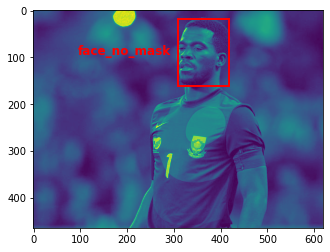

5382.jpg has 2 label(s)
9877    ../Dataset/mask_image_data/images/5382.jpg
9878    ../Dataset/mask_image_data/images/5382.jpg
Name: image_file_dir, dtype: object
['face_other_covering', 'face_other_covering']


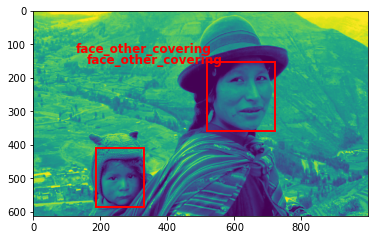

133.jpg has 2 label(s)
18783    ../Dataset/yolo/images/train/133.jpg
19965    ../Dataset/yolo/images/valid/133.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask']


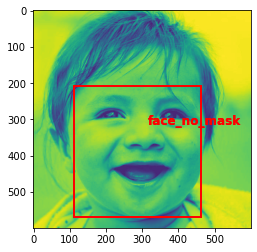

6182.jpg has 1 label(s)
11040    ../Dataset/mask_image_data/images/6182.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


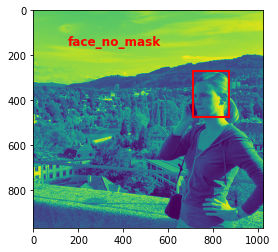

5526.jpg has 1 label(s)
10076    ../Dataset/mask_image_data/images/5526.jpg
Name: image_file_dir, dtype: object
['face_other_covering']


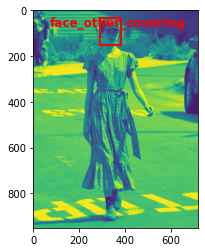

6341.jpg has 7 label(s)
11366    ../Dataset/mask_image_data/images/6341.jpg
11367    ../Dataset/mask_image_data/images/6341.jpg
11368    ../Dataset/mask_image_data/images/6341.jpg
11369    ../Dataset/mask_image_data/images/6341.jpg
11370    ../Dataset/mask_image_data/images/6341.jpg
11371    ../Dataset/mask_image_data/images/6341.jpg
11372    ../Dataset/mask_image_data/images/6341.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask', 'face_no_mask']


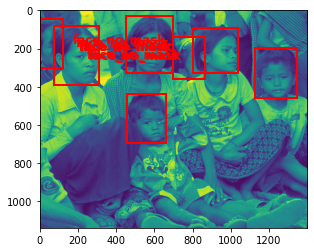

6383.jpg has 1 label(s)
11446    ../Dataset/mask_image_data/images/6383.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


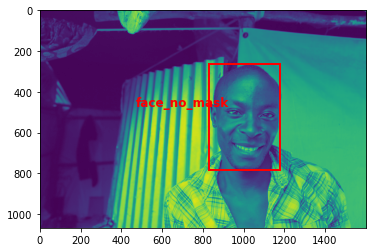

2085.jpg has 2 label(s)
858    ../Dataset/mask_image_data/images/2085.jpg
859    ../Dataset/mask_image_data/images/2085.jpg
Name: image_file_dir, dtype: object
['face_mask', 'face_with_mask']


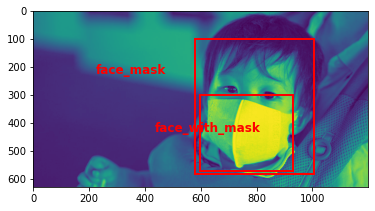

96.jpg has 1 label(s)
18921    ../Dataset/yolo/images/train/96.jpg
Name: image_file_dir, dtype: object
['face_no_mask']


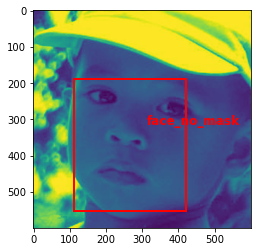

4499.png has 8 label(s)
7448    ../Dataset/mask_image_data/images/4499.png
7449    ../Dataset/mask_image_data/images/4499.png
7450    ../Dataset/mask_image_data/images/4499.png
7451    ../Dataset/mask_image_data/images/4499.png
7452    ../Dataset/mask_image_data/images/4499.png
7453    ../Dataset/mask_image_data/images/4499.png
7454    ../Dataset/mask_image_data/images/4499.png
7455    ../Dataset/mask_image_data/images/4499.png
Name: image_file_dir, dtype: object
['face_mask', 'face_mask', 'face_mask', 'face_with_mask', 'face_with_mask', 'face_other_covering', 'face_with_mask', 'face_no_mask']


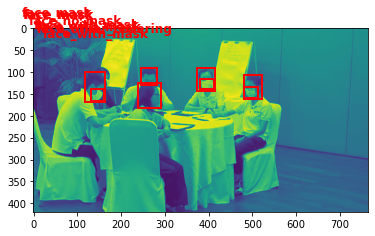

In [119]:
import random
def plot_image_with_all_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        rect = patches.Rectangle(
            (row['x1'],row['x2']),
            row['y1'],
            row['y2'],
            linewidth=2,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
        ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
        class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
name_ls =list(set(train['name']))
random.shuffle(name_ls)

for f in name_ls[0:10]:
    plot_image_with_all_bboxes(f)
    
    

# Plot Only Mask Annotations

5265.jpg has 2 label(s)
9726    ../Dataset/mask_image_data/images/5265.jpg
9727    ../Dataset/mask_image_data/images/5265.jpg
Name: image_file_dir, dtype: object
['face_mask']


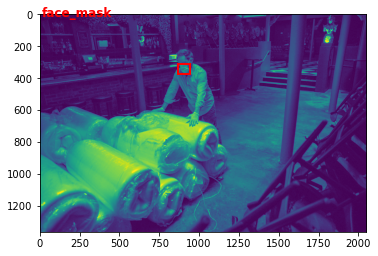

3340.png has 2 label(s)
4051    ../Dataset/mask_image_data/images/3340.png
4052    ../Dataset/mask_image_data/images/3340.png
Name: image_file_dir, dtype: object
['face_mask']


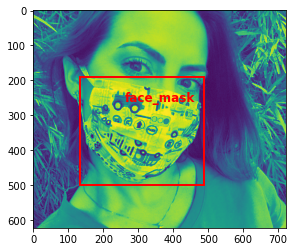

2336.png has 3 label(s)
1479    ../Dataset/mask_image_data/images/2336.png
1480    ../Dataset/mask_image_data/images/2336.png
1481    ../Dataset/mask_image_data/images/2336.png
Name: image_file_dir, dtype: object
['face_mask']


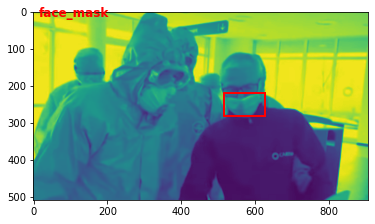

4820.png has 2 label(s)
8412    ../Dataset/mask_image_data/images/4820.png
8413    ../Dataset/mask_image_data/images/4820.png
Name: image_file_dir, dtype: object
['face_mask']


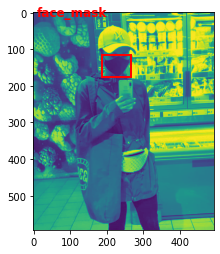

4405.png has 2 label(s)
7235    ../Dataset/mask_image_data/images/4405.png
7236    ../Dataset/mask_image_data/images/4405.png
Name: image_file_dir, dtype: object
['face_mask']


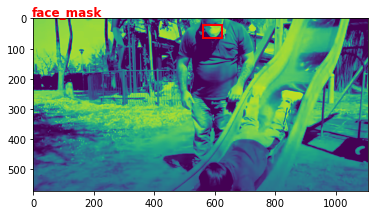

4944.png has 2 label(s)
8747    ../Dataset/mask_image_data/images/4944.png
8748    ../Dataset/mask_image_data/images/4944.png
Name: image_file_dir, dtype: object
['face_mask']


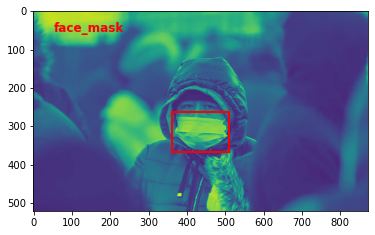

3943.png has 2 label(s)
5859    ../Dataset/mask_image_data/images/3943.png
5860    ../Dataset/mask_image_data/images/3943.png
Name: image_file_dir, dtype: object
['face_mask']


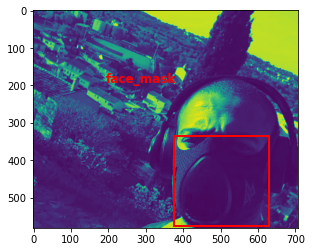

5111.jpg has 2 label(s)
9262    ../Dataset/mask_image_data/images/5111.jpg
9263    ../Dataset/mask_image_data/images/5111.jpg
Name: image_file_dir, dtype: object
['face_mask']


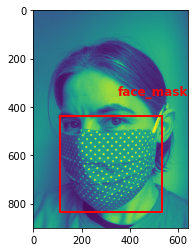

3957.png has 2 label(s)
5901    ../Dataset/mask_image_data/images/3957.png
5902    ../Dataset/mask_image_data/images/3957.png
Name: image_file_dir, dtype: object
['face_mask']


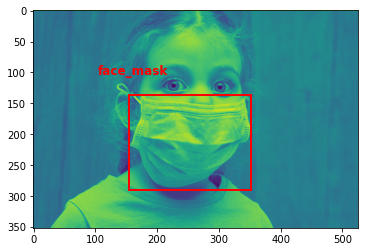

4259.png has 2 label(s)
6849    ../Dataset/mask_image_data/images/4259.png
6850    ../Dataset/mask_image_data/images/4259.png
Name: image_file_dir, dtype: object
['face_mask']


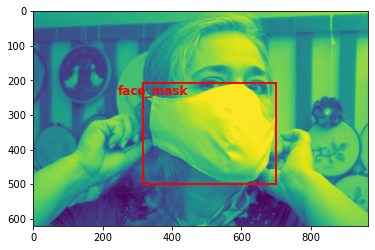

In [122]:
import random
def plot_image_with_mask_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        if row['classname'] == 'face_mask':
            rect = patches.Rectangle(
                (row['x1'],row['x2']),
                row['y1'],
                row['y2'],
                linewidth=2,edgecolor='r',facecolor='none')
            ax.add_patch(rect)
            ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
            class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
name_ls =list(set(train[train['classname'] == 'face_mask']['name']))
random.shuffle(name_ls)

for f in name_ls[0:10]:
    plot_image_with_mask_bboxes(f)
    
    

# Plot Only Face Annotations

1881.jpg has 3 label(s)
190    ../Dataset/mask_image_data/images/1881.jpg
191    ../Dataset/mask_image_data/images/1881.jpg
192    ../Dataset/mask_image_data/images/1881.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask']


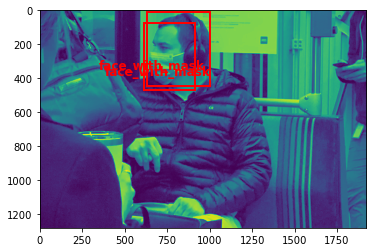

2221.png has 2 label(s)
1188    ../Dataset/mask_image_data/images/2221.png
1189    ../Dataset/mask_image_data/images/2221.png
Name: image_file_dir, dtype: object
['face_with_mask']


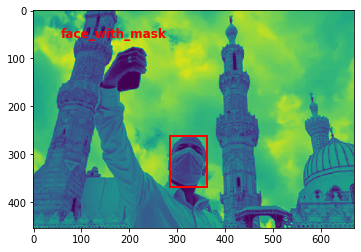

100.jpg has 2 label(s)
18751    ../Dataset/yolo/images/train/100.jpg
19956    ../Dataset/yolo/images/valid/100.jpg
Name: image_file_dir, dtype: object
['face_no_mask', 'face_no_mask']


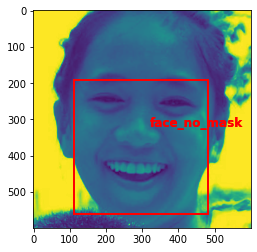

3LATF2VNPMIG4C61K0B9.jpg has 2 label(s)
12386    ../Dataset/mask_dataset/3LATF2VNPMIG4C61K0B9.jpg
12387    ../Dataset/mask_dataset/3LATF2VNPMIG4C61K0B9.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask']


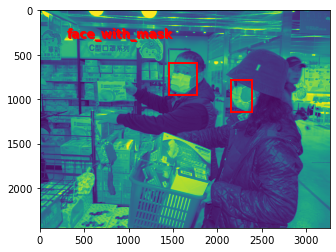

3639.png has 2 label(s)
4872    ../Dataset/mask_image_data/images/3639.png
4873    ../Dataset/mask_image_data/images/3639.png
Name: image_file_dir, dtype: object
['face_with_mask']


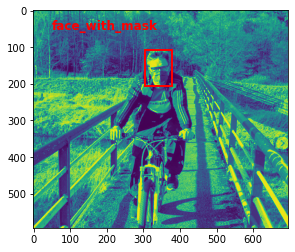

5489.jpg has 1 label(s)
10030    ../Dataset/mask_image_data/images/5489.jpg
Name: image_file_dir, dtype: object
['face_other_covering']


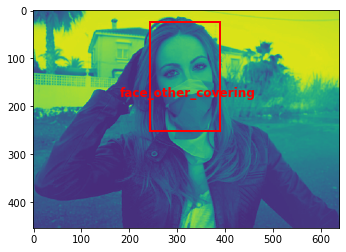

ETX9CG652WBVOS4Y17ZM.jpg has 3 label(s)
12109    ../Dataset/mask_dataset/ETX9CG652WBVOS4Y17ZM.jpg
12110    ../Dataset/mask_dataset/ETX9CG652WBVOS4Y17ZM.jpg
12111    ../Dataset/mask_dataset/ETX9CG652WBVOS4Y17ZM.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask']


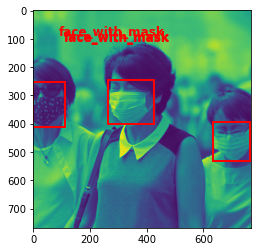

2778.png has 2 label(s)
2620    ../Dataset/mask_image_data/images/2778.png
2621    ../Dataset/mask_image_data/images/2778.png
Name: image_file_dir, dtype: object
['face_with_mask']


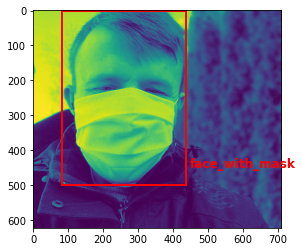

maksssksksss127.png has 1 label(s)
18048    ../Dataset/dataset_4/images/maksssksksss127.png
Name: image_file_dir, dtype: object
['face_with_mask']


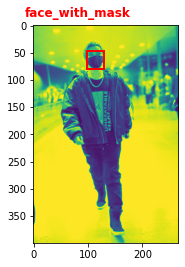

5007.jpg has 6 label(s)
8884    ../Dataset/mask_image_data/images/5007.jpg
8885    ../Dataset/mask_image_data/images/5007.jpg
8886    ../Dataset/mask_image_data/images/5007.jpg
8887    ../Dataset/mask_image_data/images/5007.jpg
8888    ../Dataset/mask_image_data/images/5007.jpg
8889    ../Dataset/mask_image_data/images/5007.jpg
Name: image_file_dir, dtype: object
['face_with_mask', 'face_with_mask', 'face_with_mask']


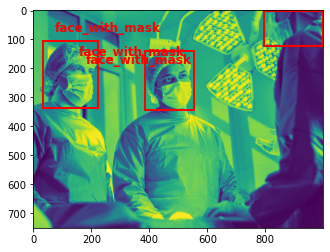

In [123]:
import random
def plot_image_with_face_bboxes(img_nm):
    dat = train[train['name'] == img_nm]
    print(img_nm,"has",len(dat),'label(s)')
    print(dat['image_file_dir']+img_nm)
    
    img = cv2.imread(dat.iloc[0]['image_file_dir']+img_nm,cv2.IMREAD_GRAYSCALE)
    fig,ax = plt.subplots(1)
    ax.imshow(img)
    class_name_ls = []
    for index,row in dat.iterrows():
        if row['classname'] != 'face_mask':
            rect = patches.Rectangle(
                (row['x1'],row['x2']),
                row['y1'],
                row['y2'],
                linewidth=2,edgecolor='r',facecolor='none')
            ax.add_patch(rect)
            ax.text(row['y2']-50, row['y2']-50, row['classname'], fontsize=12,color='r',fontweight='bold')
            class_name_ls.append(row['classname'])
    print(class_name_ls)
    plt.show()
name_ls =list(set(train['name']))
random.shuffle(name_ls)

for f in name_ls[0:10]:
    plot_image_with_face_bboxes(f)
    
    